# Projekt: CRISP-DM Prozess anhand des TMDb Movies Dataset
### Marc-David Krain // 527373

## Inhaltsverzeichnis
<ul>
<li><a href="#intro">Einleitung, Motivation & CRISP-DM Prozess</a></li>
<li><a href="#importing">Vorbereitung</a></li>
<li><a href="#Understanding1">Business Understanding</a></li>
<li><a href="#Understanding2">Data Understanding</a></li>
<li><a href="#Prep">Data Preparation</a></li>
<li><a href="#eda">Modeling/Exploratory Data Analysis & Evaluation</a></li>
<li><a href="#conclusions">Zusammenfassung</a></li>
<li><a href="#conclusions2">Schlusswort</a></li>
<li><a href="#literature">Literaturverzeichnis</a></li>
</ul>

<a id='intro'></a>
## Einleitung, Motivation & CRISP-DM Prozess

#### Einleitung
Das TMDb Movies Datenset enthält kategorische und numerische Einträge für über 10.000 
Filme, der letzten 5 Jahrzehnte. So sind zum Beispiel Aspekte wie Budget, Umsätze, Schauspieler, Produktionsstudio oder das Jahr der Veröffentlichung in disem Datenset enthalten.<sup>1</sup>

Das zusätzlich zu diesem Notebooks erstellte GitHub Repository, lässt sich unter der folgenden URL finden: https://github.com/MDK1192/MBB19_AngeProg

#### Motivation
Innerhalb diesem Jupyter Notebook möchte ich die Projektleistung für das Modul "Angewandte Programmierung" des Masterstudiengangs "Big Data & Business Analytics" der Fom-Hochschule abliefern. Darüber hinaus möchte ich Möglichkeiten von Interaktiven Visualisierungen in Kombination mit Jupyter Notebooks testen, um gegebenenfalls ein Template für Reports anderer Art in der Zukunft bereitzustellen.

#### CRISP-DM Prozess
Bei CRISP-DM handelt es sich um einen Unternehmensübergreifenden Standart für die Vorgehenseweise bei der Analyse von Daten beziehungsweise das Data Mining.<sup>2</sup>

CRISP-DM besteht aus den folgenden sechs Phasen, die sich wie folgt beschreiben lassen können: 

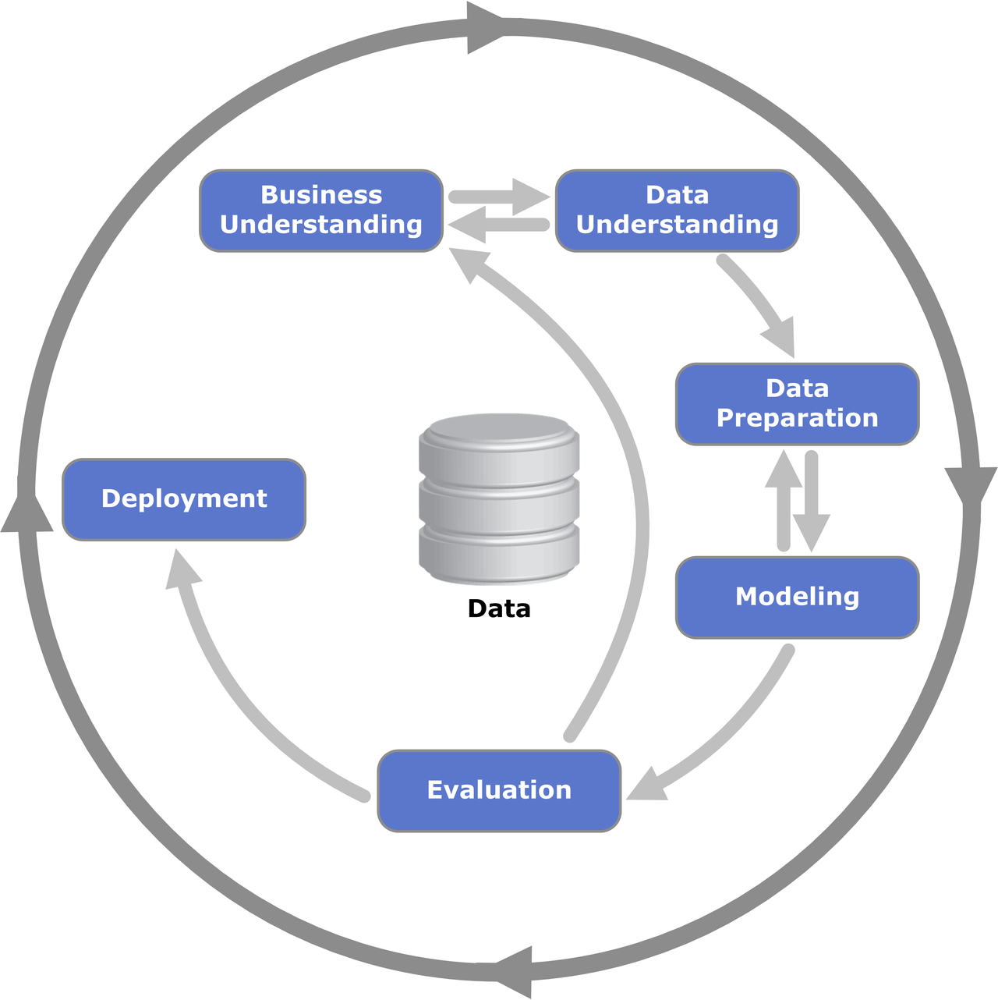

#### Business understanding

"This initial phase focuses on understanding the project objectives and requirements from a business perspective,
then converting this knowledge into a data mining problem definition and a preliminary plan designed to achieve
the objectives."<sup>3</sup>

#### Data understanding

"The data understanding phase starts with initial data collection and proceeds with activities that enable you to
become familiar with the data, identify data quality problems, discover first insights into the data, and/or detect
interesting subsets to form hypotheses regarding hidden information."<sup>4</sup>

#### Data preparation

"The data preparation phase covers all activities needed to construct the final dataset [data that will be fed into the
modeling tool(s)] from the initial raw data. Data preparation tasks are likely to be performed multiple times and not
in any prescribed order. Tasks include table, record, and attribute selection, as well as transformation and cleaning
of data for modeling tools."<sup>5</sup>

#### Modeling

"In this phase, various modeling techniques are selected and applied, and their parameters are calibrated to optimal
values. Typically, there are several techniques for the same data mining problem type. Some techniques have specific
requirements on the form of data. Therefore, going back to the data preparation phase is often necessary."<sup>6</sup>

#### Evaluation

"At this stage in the project, you have built a model (or models) that appears to have high quality from a data analysis
perspective. Before proceeding to final deployment of the model, it is important to thoroughly evaluate it and review
the steps executed to create it, to be certain the model properly achieves the business objectives. A key objective is
to determine if there is some important business issue that has not been sufficiently considered. At the end of this
phase, a decision on the use of the data mining results should be reached."<sup>7</sup>

#### Deployment

"Creation of the model is generally not the end of the project. Even if the purpose of the model is to increase knowledge
of the data, the knowledge gained will need to be organized and presented in a way that the customer can use it. It
often involves applying “live” models within an organization’s decision making processes—for example, real-time
personalization of Web pages or repeated scoring of marketing databases. Depending on the requirements, the
deployment phase can be as simple as generating a report or as complex as implementing a repeatable data mining
process across the enterprise. In many cases, it is the customer, not the data analyst, who carries out the deployment
steps. However, even if the analyst will carry out the deployment effort, it is important for the customer to understand
up front what actions need to be carried out in order to actually make use of the created models."<sup>8</sup>

Entsprechend der Elemente des CRISP-DM Prozesses, möchte ich mich innerhalb dieses Notebooks auf die Datenanalyse und Insight-Discovery konzentrieren. Dementsprechend wird geringerer Fokus auf dem Teilabschnitt Deployment und der Schwerpunkt auf den Schritten Business & Data Understanding, Data Preparation & Modeling (hier Analyse) als auch Evaluation in einer abgewandelten Form, begleitend zu Modeling, liegen.

<a id='importing'></a>
## Vorbereitung 
Bevor ich mit den Schritten von CRISP-DM beginne, werde ich benötigte libraries sowie die Daten importieren.

### Installieren von dependencies

Zunächst möchte ich R-Packages installieren und laden, die für den gesamten folgenden CRISP-DM Prozess benötigt werden, um Vorgänge wie Data Wrangling oder Visualisierung durchführen zu können.<sup>9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19 </sup>

In [1]:
#installieren von packages
install.packages("naniar")
install.packages("plotly")
install.packages("lubridate")
install.packages("openair")

Installing package into ‘/srv/rlibs’
(as ‘lib’ is unspecified)
also installing the dependencies ‘visdat’, ‘UpSetR’

Installing package into ‘/srv/rlibs’
(as ‘lib’ is unspecified)
also installing the dependencies ‘hexbin’, ‘data.table’

Installing package into ‘/srv/rlibs’
(as ‘lib’ is unspecified)
Installing package into ‘/srv/rlibs’
(as ‘lib’ is unspecified)
also installing the dependencies ‘maps’, ‘latticeExtra’, ‘mapproj’



In [2]:
#laden von packages
library(ggplot2)
library(tidyr)
library(readr)
library(dplyr)
library(plotly)
library(naniar)
library(visdat)
library(lubridate)
library(openair)
library(data.table)

Registered S3 methods overwritten by 'ggplot2':
  method         from 
  [.quosures     rlang
  c.quosures     rlang
  print.quosures rlang

Attaching package: ‘dplyr’

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Attaching package: ‘plotly’

The following object is masked from ‘package:ggplot2’:

    last_plot

The following object is masked from ‘package:stats’:

    filter

The following object is masked from ‘package:graphics’:

    layout


Attaching package: ‘lubridate’

The following object is masked from ‘package:base’:

    date


Attaching package: ‘data.table’

The following objects are masked from ‘package:lubridate’:

    hour, isoweek, mday, minute, month, quarter, second, wday, week,
    yday, year

The following objects are masked from ‘package:dplyr’:

    between, first, last



### Datenset importieren

In [3]:
#importieren der Daten
data <- read_csv("tmdb_movies_data.csv")

Parsed with column specification:
cols(
  .default = col_character(),
  id = col_double(),
  popularity = col_double(),
  budget = col_double(),
  revenue = col_double(),
  runtime = col_double(),
  vote_count = col_double(),
  vote_average = col_double(),
  release_year = col_double(),
  budget_adj = col_double(),
  revenue_adj = col_double()
)
See spec(...) for full column specifications.


<a id='Understanding1'></a>
## Business Understanding

Bevor ich mit der Analyse und weiteren mit CRISP-DM verknüpften Inhalten und Tätigkeiten beginne, ist es wichtig generelle Eigenschaften der Daten zu verstehen. Der erste Schritt hierfür ist das Business Understanding, was in dem Kontext von diesem Notebook heißt, das Umfeld der Daten zu verstehen und konkrete Fragen zu formulieren.

Da es sich hier bei um ein Datenset aus der Filmbranche handelt, können naheligende Fragstellungen, in einem wirtschaftlichen und sozialen Kontext gestellt werden, zum Beispiel welche der Einträge des Datensets in den eben beschriebenen Punkten herausstechen, oder ob es Veränderungen über die aufgenommene Zeit gibt. Der Schwerpunkt des Data Mining Prozesses, der im Anschluss folgt, wird sich dementsprechend auf die eben beschriebenen wirtschaftlichen und sozialen Aspekte fokussieren und diese gegebnenfalls unter dem Aspekt der Trendveränderungen über Jahrzehnte beobachten.

Ausformulierte Fragen, die ich mit dieser Datenanalyse beantworten möchte, sind die folgenden:

- Welche Schauspieler haben in den meisten Filmen mitgewirkt?
- Welche Filme sind am besten und am schlechtesten bewertet?
- Gibt es über die Jahrzehnte hinweg Veränderungen in den Laufzeiten der Filme?
- Gibt es über die Jahrzehnte hinweg Veränderungen in den Budgets der Filme?
- Gibt es über die Jahrzehnte hinweg Veränderungen in den Genrefrequenz der Filme?

<a id='Understanding'></a>
## Data Understanding

Folgend auf das Business Understanding, ist nun das Data Understanding der nächste logische Schritt. Hierfür werde ich mich auf essentielle Eigenschaften des Datensets konzentrieren, um ein Verständnis zu bekommen mit welchen Features man welche Fragestellungen am besten beantworten kann. Beginnend möchte ich mich auf die Semantik hinter den Features konzentrieren, da hierfür keine vom Distributor des Datensets angebotetenen Informationen bereitstehen, werde ich diese anhand der Features und der entsprechenden Einträge selbst erstellen.

In [4]:
#Einträge unter Features inspizieren
head(data, 1)

id,imdb_id,popularity,budget,revenue,original_title,cast,homepage,director,tagline,⋯,overview,runtime,genres,production_companies,release_date,vote_count,vote_average,release_year,budget_adj,revenue_adj
<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
135397,tt0369610,32.98576,1.5e+08,1513528810,Jurassic World,Chris Pratt|Bryce Dallas Howard|Irrfan Khan|Vincent D'Onofrio|Nick Robinson,http://www.jurassicworld.com/,Colin Trevorrow,The park is open.,⋯,"Twenty-two years after the events of Jurassic Park, Isla Nublar now features a fully functioning dinosaur theme park, Jurassic World, as originally envisioned by John Hammond.",124,Action|Adventure|Science Fiction|Thriller,Universal Studios|Amblin Entertainment|Legendary Pictures|Fuji Television Network|Dentsu,6/9/2015,5562,6.5,2015,137999939,1392445893


Zusammenfassend, konnte ich die folgenden Features wie folgt zusammenfassen:

- 'id': Eine einzigartige ID, um Einträge innerhalb einer Datenbank zu referenzieren.
- 'imdb_id': Eine einzigartige ID, um Einträge innerhalb einer Datenbank zu referenzieren.
- 'popularity': Numerischer Wert, der eine Auskunft über den Beliebtheitsgrad eines Filmes gibt.
- 'budget': Numerischer Wert, der eine Auskunft über das verwendete Budget eines Filmes gibt.
- 'revenue': Numerischer Wert, der eine Auskunft über den erzeugten Umsatz eines Filmes gibt.
- 'original_title': Der Name des Filmes.
- 'cast': Eine Liste der in einem Fil vorkommenden Schauspieler.
- 'homepage': Eine URL zu der Homepage eines Filmes.
- 'director': Der Name/Die Namen der an einem Film beteiligten Direktoren.
- 'tagline': Die Tagline eines Films z.B.: "I'll be back!/hasta la vista baby! -Terminator".
- 'keywords': Beschreibende Schlüsselterme, die zu einem Film passen z.B: "Robot/Dystopie/AI/Science Fiction - Terminator".
- 'overview': Eine kurze Inhaltsbeschreibung eines Films
- 'runtime': Die Laufzeit eines Films in Minuten.
- 'genres': Eine Liste von Genres, die zu einem Film zugeordnet wurden.
- 'production_companies': Eine Liste von Produktionsunternhmen, die an der Entiwcklung eines Films beteiligt waren.
- 'release_date': Das Erscheinungsdatum eines Films in Kinos.
- 'vote_count': Numerischer Wert, der eine Auskunft über die Anzahl der Kritiken eines Filmes gibt.
- 'vote_average': Numerischer Wert, der eine Auskunft über den Durchschnitt der Kritiken eines Filmes gibt.
- 'release_year': Das Erscheinungsjahr eines Filmes.
- 'budget_adj': Numerischer Wert, der eine Auskunft über das angepasste verwendete Budget eines Filmes gibt.
- 'revenue_adj': Numerischer Wert, der eine Auskunft über den angepassten erzeugten Umsatz eines Filmes gibt.

<a id='Prep'></a>
## Data Preparation

Der nächste logische Schritt an diesem Punkt, ist der Übergang zu der Phase Data Preparation. Innerhalb von dieser möchte ich den Datensatz für die Analyse Vorbereiten, Nicht vorhandene Einträge verarbeiten, Anomalien und Auffälligkeiten bearbeiten sowie weitere Features hinzufügen

### Data Inspection & Cleaning 

Zunächst möchte einen weiteren gröberen Blick auf die Daten werfen, um eine Einsicht in Einträge und Datentypen des Datensets zu erhalten.

In [5]:
#Überblick über Datentypen und Einträge 
glimpse(data)

Observations: 10,866
Variables: 21
$ id                   <dbl> 135397, 76341, 262500, 140607, 168259, 281957, 8…
$ imdb_id              <chr> "tt0369610", "tt1392190", "tt2908446", "tt248849…
$ popularity           <dbl> 32.985763, 28.419936, 13.112507, 11.173104, 9.33…
$ budget               <dbl> 1.50e+08, 1.50e+08, 1.10e+08, 2.00e+08, 1.90e+08…
$ revenue              <dbl> 1513528810, 378436354, 295238201, 2068178225, 15…
$ original_title       <chr> "Jurassic World", "Mad Max: Fury Road", "Insurge…
$ cast                 <chr> "Chris Pratt|Bryce Dallas Howard|Irrfan Khan|Vin…
$ homepage             <chr> "http://www.jurassicworld.com/", "http://www.mad…
$ director             <chr> "Colin Trevorrow", "George Miller", "Robert Schw…
$ tagline              <chr> "The park is open.", "What a Lovely Day.", "One …
$ keywords             <chr> "monster|dna|tyrannosaurus rex|velociraptor|isla…
$ overview             <chr> "Twenty-two years after the events of Jurassic P…
$ runtime        

Es ist erkennbar, dass nicht alle Features atomare Werte besitzen, was heißt, dass ich mich diesem Umstand, um diese Feautures mit in die Analyse aufzunehmen, annehmen muss. Weiterhin scheinen, ausgehend von dem im Business Understanding erarbeiteten Schwerpunkts auf wirtschaftliche und soziale Aspekte des Datenset, bestimmte Features redundant zu sein. Beispielsweise haben wir zwei Spalten mit eindeuten ID-Werten aus denen keine nennenswerten Einsichten generiert werden können. Da aber kein Model auf diese Daten trainiert werden soll, sondern lediglich einen Analyse mit Fokus auf EDA vorgenommen, ist ein Ignorieren dieser Spalten vorerst genügend.

Weiterhin möchte ich, um auch statistische und visuelle Zusammenfassungen der Features hinzuzufügen einen Überblick über diese Werte geben.

In [6]:
#Statistische Zusammenfassung der Daten, Anomalien würden hier Auffällig werden.
summary(data)

       id           imdb_id            popularity           budget         
 Min.   :     5   Length:10866       Min.   : 0.00006   Min.   :        0  
 1st Qu.: 10596   Class :character   1st Qu.: 0.20758   1st Qu.:        0  
 Median : 20669   Mode  :character   Median : 0.38386   Median :        0  
 Mean   : 66064                      Mean   : 0.64644   Mean   : 14625701  
 3rd Qu.: 75610                      3rd Qu.: 0.71382   3rd Qu.: 15000000  
 Max.   :417859                      Max.   :32.98576   Max.   :425000000  
    revenue          original_title         cast             homepage        
 Min.   :0.000e+00   Length:10866       Length:10866       Length:10866      
 1st Qu.:0.000e+00   Class :character   Class :character   Class :character  
 Median :0.000e+00   Mode  :character   Mode  :character   Mode  :character  
 Mean   :3.982e+07                                                           
 3rd Qu.:2.400e+07                                                           


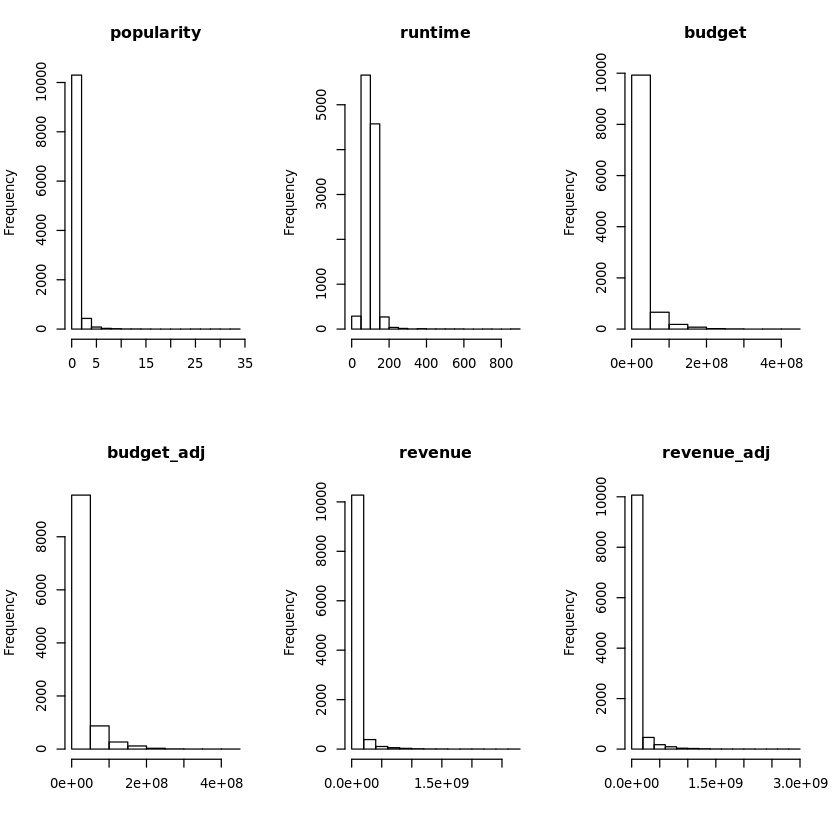

In [7]:
par(mfrow=c(2,3))
hist(na.omit(data$popularity), main = "popularity", xlab="")
hist(na.omit(data$runtime), main = "runtime", xlab="")
hist(na.omit(data$budget), main = "budget", xlab="")
hist(na.omit(data$budget_adj), main = "budget_adj", xlab="")
hist(na.omit(data$revenue), main = "revenue", xlab="")
hist(na.omit(data$revenue_adj), main = "revenue_adj", xlab="")

Bei einem Blick auf die statistische Zusammemnfassung ist erkenntlich, dass die numerischen Features 'popularity', 'runtime' 'budget', 'budget_adj', 'revenue' und 'revenue_adj' statistisch gesehen sehr große maximalwerte haben. Die Visualisierungen konnten zeigen, dass die oben genannten Features eine linksschiefe Verteilung haben.

<a id='NA'></a>
### Analyse der fehlenden Einträge

Nachdem ich mich mit essentiellen Größen über eine statistische und visuelle Analyse weitergehend mit den Daten vertraut machen konnte, liegt mein nächster Schritt darin, die daten auf fehlenden Einträge zu überprüfen und zu evaluieren, wie ich mit diesen verfahre.

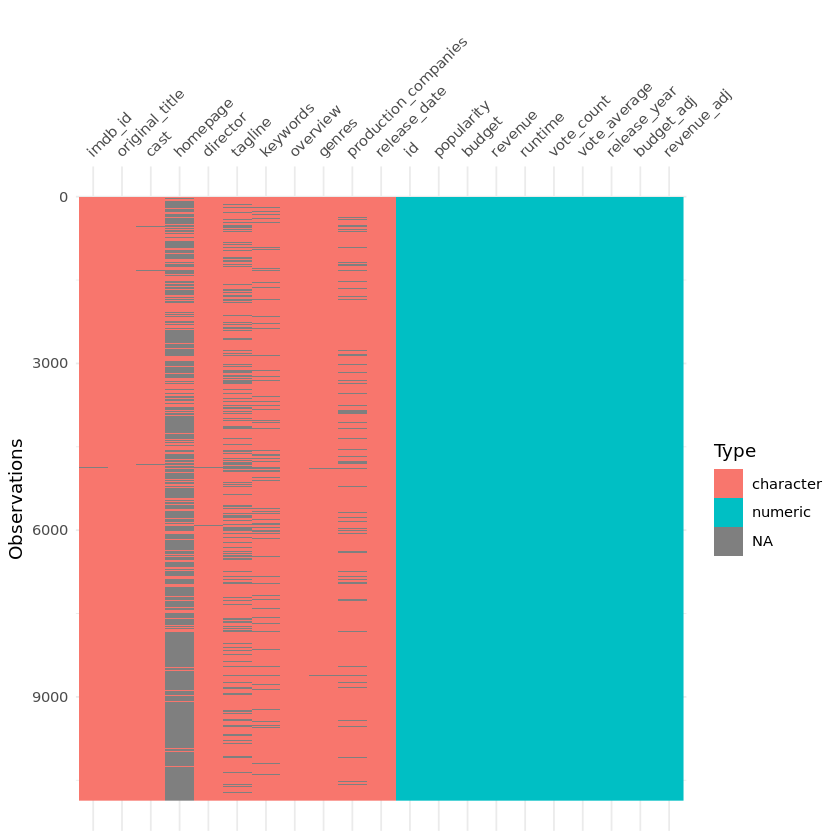

In [8]:
#visualisierung der fehlenden Einträge
vis_dat(data)

Der erste Blick auf die fehlenden Einträge zeigt, dass scheinbar 3-4 Features sehr hohe Anteile an fehlenden Einträgen aufweisen. Diese Features sind 'homepage', 'tagline', 'keywords', und 'production_companies'.

In [9]:
#NAs in prozent
miss_var_summary(data)

variable,n_miss,pct_miss
<chr>,<int>,<dbl>
homepage,7930,72.97993742
tagline,2824,25.98932450
keywords,1493,13.74010676
production_companies,1030,9.47910915
cast,76,0.69942941
director,44,0.40493282
genres,23,0.21166943
imdb_id,10,0.09203019
overview,4,0.03681207


Dies weitergehend betrachtend, können wir die prozentualen Werte betrachten und konkrete Anteile an fehlenden Werten ausgeben.

Da im Kontext der Analyse weder 'homepage' noch 'tagline' nennenswerte Einsichten bringt, habe ich mich dazu entschieden, diese Spalten zu entfernen. Allerdings möchte ich an dieser Stelle noch nicht die Features 'keywords' & 'production_company' entfernen, da diese noch interessante Einsichten ermöglichen könnten. 

An dieser Stelle stellt sich die Frage, ob ich diese fehlenden Werte schätze, entferne, oder unbehandelt übernehme.

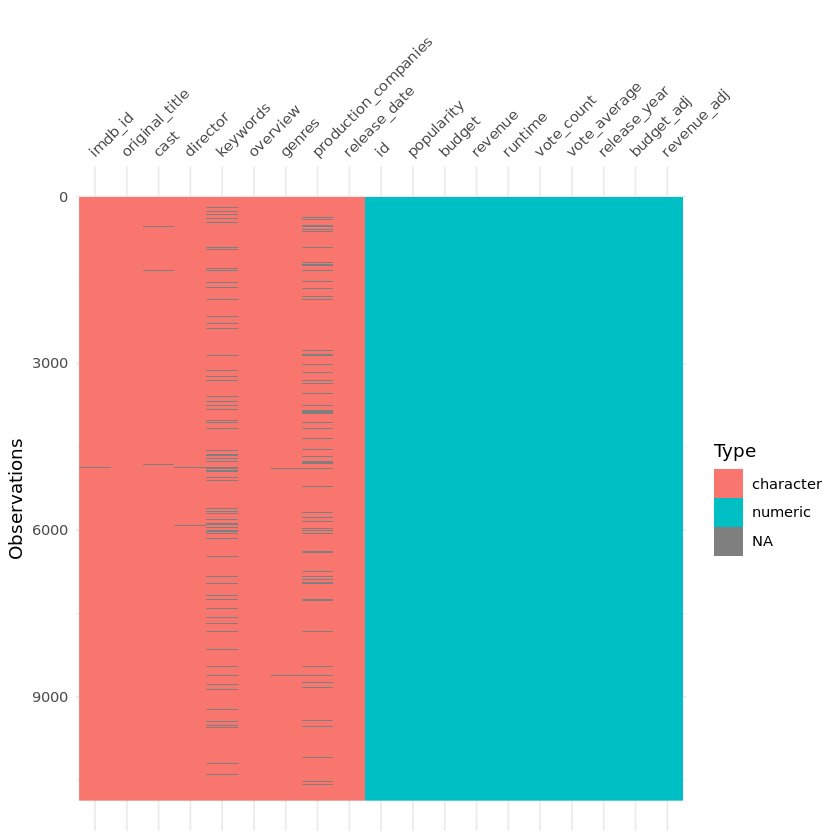

In [10]:
#entferne "homepage" und "tagline"
data <- dplyr::select(data,-c("homepage","tagline"))
vis_dat(data)

Ein interesannter Aspekt an dieser Stelle, ist die Frage, ob vorhandene Fehleinträge eine gegenseitige Abhängigkeit aufweisen, wie zum Beispiel bei MNAR oder MAR. Dies möchte ich durch weitere Plots visuell überprüfen.

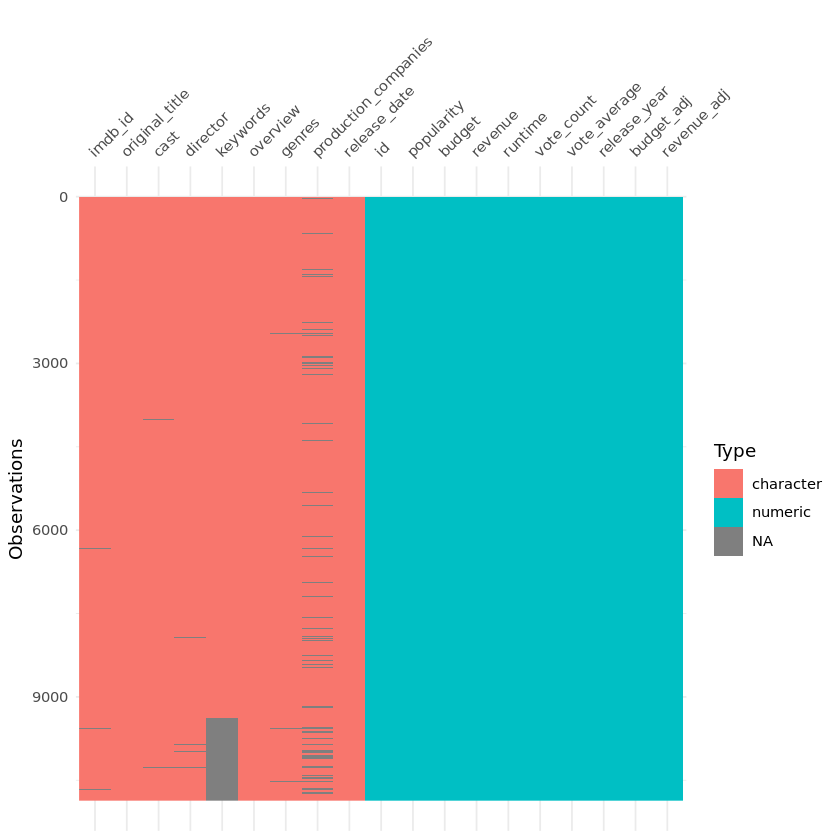

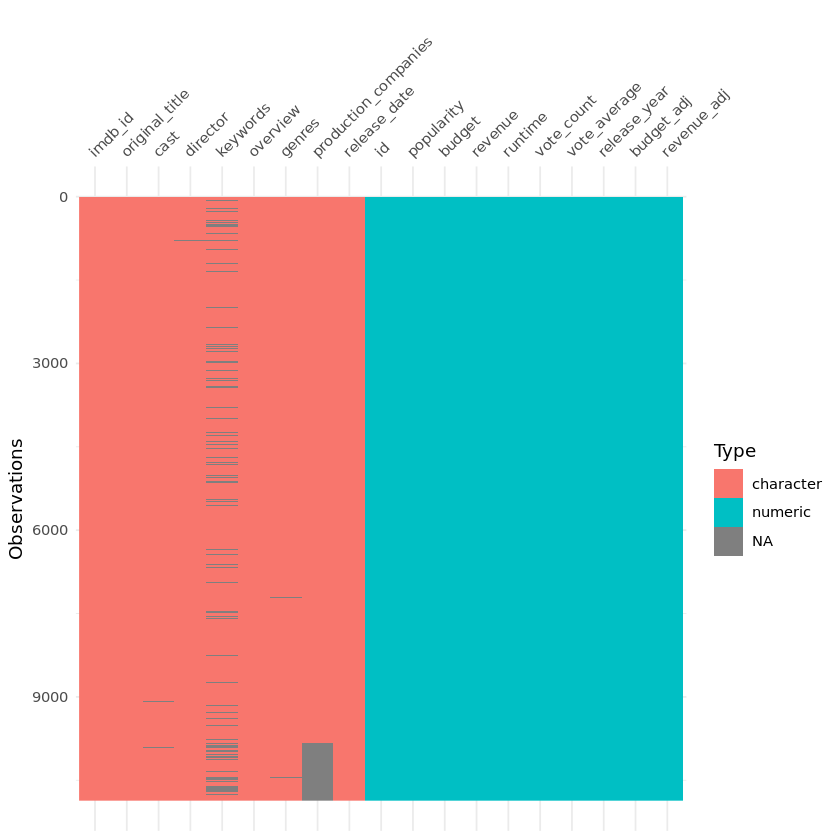

In [11]:
#Überprüfen der fehlenden Einträge auf gegenseitige Abhängigkeit
data %>% arrange(keywords) %>% vis_dat()
data %>% arrange(production_companies) %>% vis_dat()

In beiden Fällen scheint das Muster verhältnismäßig zufälig unter Sortierung nach der anderen Spalte. 

Da der prozentuale Anteil an fehlenden Einträgen verhältnismäßig gering erscheint und der Fokus auf einer EDA liegen wird, habe ich mich dazu entschieden die Daten nicht zu manipulieren und die NA-Infomrationen wie aktuell vorhanden zu übernehmen, da ein Reihenweisen löschen viele Details aus den Daten entfernen würde und Hot-Desk Imputing zu inkorrekten Schätzungen führen kann und nicht notwendig ist, da kein Model zum Einsatz kommt.

Weiterhin relevant, ist die Überprüfung auf Replikate innerhalb des Datensatzes, weshalb ich als nächsten Schritt hierauf testen werde.

In [12]:
#Überprüfe nach Bool-Methode auf Duplikate
sum(duplicated(data))
data[duplicated(data),]
data[data$id == "42194",]
nrow(data)

#Entferne doppelte Einträge
data <- data %>% distinct() 
nrow(data)

#Überprüfen, ob Eintrag entrfernt wurde
data[data$id == "42194",]

[1] 1

id,imdb_id,popularity,budget,revenue,original_title,cast,director,keywords,overview,runtime,genres,production_companies,release_date,vote_count,vote_average,release_year,budget_adj,revenue_adj
<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
42194,tt0411951,0.59643,3e+07,967000,TEKKEN,Jon Foo|Kelly Overton|Cary-Hiroyuki Tagawa|Ian Anthony Dale|Luke Goss,Dwight H. Little,martial arts|dystopia|based on video game|martial arts tournament,"In the year of 2039, after World Wars destroy much of the civilization as we know it, territories are no longer run by governments, but by corporations; the mightiest of which is the Mishima Zaibatsu. In order to placate the seething masses of this dystopia, Mishima sponsors Tekken, a tournament in which fighters battle until only one is left standing.",92,Crime|Drama|Action|Thriller|Science Fiction,Namco|Light Song Films,3/20/2010,110,5,2010,3e+07,967000


id,imdb_id,popularity,budget,revenue,original_title,cast,director,keywords,overview,runtime,genres,production_companies,release_date,vote_count,vote_average,release_year,budget_adj,revenue_adj
<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
42194,tt0411951,0.59643,3e+07,967000,TEKKEN,Jon Foo|Kelly Overton|Cary-Hiroyuki Tagawa|Ian Anthony Dale|Luke Goss,Dwight H. Little,martial arts|dystopia|based on video game|martial arts tournament,"In the year of 2039, after World Wars destroy much of the civilization as we know it, territories are no longer run by governments, but by corporations; the mightiest of which is the Mishima Zaibatsu. In order to placate the seething masses of this dystopia, Mishima sponsors Tekken, a tournament in which fighters battle until only one is left standing.",92,Crime|Drama|Action|Thriller|Science Fiction,Namco|Light Song Films,3/20/2010,110,5,2010,3e+07,967000
42194,tt0411951,0.59643,3e+07,967000,TEKKEN,Jon Foo|Kelly Overton|Cary-Hiroyuki Tagawa|Ian Anthony Dale|Luke Goss,Dwight H. Little,martial arts|dystopia|based on video game|martial arts tournament,"In the year of 2039, after World Wars destroy much of the civilization as we know it, territories are no longer run by governments, but by corporations; the mightiest of which is the Mishima Zaibatsu. In order to placate the seething masses of this dystopia, Mishima sponsors Tekken, a tournament in which fighters battle until only one is left standing.",92,Crime|Drama|Action|Thriller|Science Fiction,Namco|Light Song Films,3/20/2010,110,5,2010,3e+07,967000


[1] 10866

[1] 10865

id,imdb_id,popularity,budget,revenue,original_title,cast,director,keywords,overview,runtime,genres,production_companies,release_date,vote_count,vote_average,release_year,budget_adj,revenue_adj
<dbl>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
42194,tt0411951,0.59643,3e+07,967000,TEKKEN,Jon Foo|Kelly Overton|Cary-Hiroyuki Tagawa|Ian Anthony Dale|Luke Goss,Dwight H. Little,martial arts|dystopia|based on video game|martial arts tournament,"In the year of 2039, after World Wars destroy much of the civilization as we know it, territories are no longer run by governments, but by corporations; the mightiest of which is the Mishima Zaibatsu. In order to placate the seething masses of this dystopia, Mishima sponsors Tekken, a tournament in which fighters battle until only one is left standing.",92,Crime|Drama|Action|Thriller|Science Fiction,Namco|Light Song Films,3/20/2010,110,5,2010,3e+07,967000


<a id='Wrangling'></a>
### Data Wrangling

Da nun die Daten erstmalig inspiziert und fehlende Werte überprüft wurden, ist der nächste Schritt meine Aufmerksamkeit auf Aspekte unter Data Wrangling zu richten. Hierfür möchte ich zunächst überprüfen, ob die Datentypen der Features stimmig sind. Weitergehend möchte ich in dem Feature Engineering weitere Features hinzufügen, sofern dies sinnvoll erscheint.

In [13]:
#Überprüfen der Datentypen
dplyr::glimpse(data)

Observations: 10,865
Variables: 19
$ id                   <dbl> 135397, 76341, 262500, 140607, 168259, 281957, 8…
$ imdb_id              <chr> "tt0369610", "tt1392190", "tt2908446", "tt248849…
$ popularity           <dbl> 32.985763, 28.419936, 13.112507, 11.173104, 9.33…
$ budget               <dbl> 1.50e+08, 1.50e+08, 1.10e+08, 2.00e+08, 1.90e+08…
$ revenue              <dbl> 1513528810, 378436354, 295238201, 2068178225, 15…
$ original_title       <chr> "Jurassic World", "Mad Max: Fury Road", "Insurge…
$ cast                 <chr> "Chris Pratt|Bryce Dallas Howard|Irrfan Khan|Vin…
$ director             <chr> "Colin Trevorrow", "George Miller", "Robert Schw…
$ keywords             <chr> "monster|dna|tyrannosaurus rex|velociraptor|isla…
$ overview             <chr> "Twenty-two years after the events of Jurassic P…
$ runtime              <dbl> 124, 120, 119, 136, 137, 156, 125, 141, 91, 94, …
$ genres               <chr> "Action|Adventure|Science Fiction|Thriller", "Ac…
$ production_comp

Hierbei ist mir das folgende aufgefallen:
- id ist numerisch, aber eigentlich ein faktor, um einträge zu referenzieren
- Datumseinträge sind Strings
- keywords, production_companies, cast and genres sind nicht atomar, hierfür wird später feature engineering notwendig sein

Die ersten beiden Punkte können direkt abgeändert werden.

In [14]:
#abändern der Datentypen
data$id <- as.factor(data$id)
data$release_date <- as.Date(data$release_date , format = "%m/%d/%Y")

In [15]:
#Überprüfen, ob Datentpyen geändert wurden
dplyr::glimpse(data)

Observations: 10,865
Variables: 19
$ id                   <fct> 135397, 76341, 262500, 140607, 168259, 281957, 8…
$ imdb_id              <chr> "tt0369610", "tt1392190", "tt2908446", "tt248849…
$ popularity           <dbl> 32.985763, 28.419936, 13.112507, 11.173104, 9.33…
$ budget               <dbl> 1.50e+08, 1.50e+08, 1.10e+08, 2.00e+08, 1.90e+08…
$ revenue              <dbl> 1513528810, 378436354, 295238201, 2068178225, 15…
$ original_title       <chr> "Jurassic World", "Mad Max: Fury Road", "Insurge…
$ cast                 <chr> "Chris Pratt|Bryce Dallas Howard|Irrfan Khan|Vin…
$ director             <chr> "Colin Trevorrow", "George Miller", "Robert Schw…
$ keywords             <chr> "monster|dna|tyrannosaurus rex|velociraptor|isla…
$ overview             <chr> "Twenty-two years after the events of Jurassic P…
$ runtime              <dbl> 124, 120, 119, 136, 137, 156, 125, 141, 91, 94, …
$ genres               <chr> "Action|Adventure|Science Fiction|Thriller", "Ac…
$ production_comp

Nachdem ich die Datentypen entsprechend angepasst habe, werde ich nun neue Features erstellen. Da der Trend über die Jahrzehnte hinweg von finanziellen/wirtschaftlichen als auch sozialen Aspekten im Fokus dieser Analyse steht, macht es Sinn eine Gruppierung in Jahrzehnte durchführen zu können, weshalb ein entsprechendes Feature benötigt wird. Weitergehend wäre es im wirtschaftlichen Kontext interessant zu wissen, wie der ROI der Filme ist, weshalb auch dieses Feature angelegt wird.

In [16]:
#Erstelle Jahrzehnt Feature
data$decade <-  as.factor(floor(data$release_year / 10) * 10)
#Erstelle ROI Feature
data$ROI <- data$revenue / data$budget

Zurückkehrend auf die nicht atomaren Feaures, die vorhin identifiziert wurden, ist mein Ansatz diese in eine nested list zu transformieren und aus dem Hauptdatensatz zu entfernen, um sie über die entsprechende IDs anzusteuern. Weiterhin möchte ich den Hauptdarsteller der Filme, das Hauptgenre sowie das primär beteiligte Studio als atomares Attribut hinzufügen.

In [17]:
#transformation der nicht atomaren Features in nested lists
list_cast <- list()
list_genres <- list()
list_studios <- list()

# füllen der listen und extraktion der Haupt-Atrtribute
for(i in 1:nrow(data)){
  data$main_actor[i] <- strsplit(data$cast[i], "|", fixed=TRUE)[[1]][1]
  data$main_genre[i] <- strsplit(data$genres[i], "|", fixed=TRUE)[[1]][1]
  data$main_studio[i] <- strsplit(data$production_companies[i], "|", fixed=TRUE)[[1]][1]
  list_cast[[i]] <- strsplit(data$cast[i], "|", fixed=TRUE)[[1]]
  list_genres[[i]] <- strsplit(data$genres[i], "|", fixed=TRUE)[[1]]
  list_studios[[i]] <- strsplit(data$production_companies[i], "|", fixed=TRUE)[[1]]
}

Warning message:
“Unknown or uninitialised column: 'main_actor'.”Warning message:
“Unknown or uninitialised column: 'main_genre'.”Warning message:
“Unknown or uninitialised column: 'main_studio'.”

Um nun zu überprüfen, ob die neuen Features das gewünschte Format haben, möchte ich mir diese noch einmal anschauen.

In [18]:
dplyr::glimpse(data)

Observations: 10,865
Variables: 24
$ id                   <fct> 135397, 76341, 262500, 140607, 168259, 281957, 8…
$ imdb_id              <chr> "tt0369610", "tt1392190", "tt2908446", "tt248849…
$ popularity           <dbl> 32.985763, 28.419936, 13.112507, 11.173104, 9.33…
$ budget               <dbl> 1.50e+08, 1.50e+08, 1.10e+08, 2.00e+08, 1.90e+08…
$ revenue              <dbl> 1513528810, 378436354, 295238201, 2068178225, 15…
$ original_title       <chr> "Jurassic World", "Mad Max: Fury Road", "Insurge…
$ cast                 <chr> "Chris Pratt|Bryce Dallas Howard|Irrfan Khan|Vin…
$ director             <chr> "Colin Trevorrow", "George Miller", "Robert Schw…
$ keywords             <chr> "monster|dna|tyrannosaurus rex|velociraptor|isla…
$ overview             <chr> "Twenty-two years after the events of Jurassic P…
$ runtime              <dbl> 124, 120, 119, 136, 137, 156, 125, 141, 91, 94, …
$ genres               <chr> "Action|Adventure|Science Fiction|Thriller", "Ac…
$ production_comp

<a id='eda'></a>
## Modeling/Exploratory Data Analysis & Evaluation

Nachdem nun alle Vorverarbeitungsschritte abgeschlossen und die Daten in einem verwertbaren Zustand sind, möchte ich nun in dem eigentlichen Analyseabschnitt auf die in dem Abschnitt Business Understanding formulierten Fragen eingehen. Hierfür werde ich für jede formulierte Frage entsprechende Statistiken und Visualisierungen verwenden und gesondert auf die Analyseergebnisse eingehen. Zeitgleich werde ich in der Zusammenfassung der Ergebnisse, sofern erforderlich, bestimmte Auffälligkeiten kritisch hinterfragen und auf Validität hin analysierien.

### Welche Schauspieler haben in den meisten Filmen mitgewirkt?

Um diese Frage zu beantworten, sollten eine einfache Statistik und ein Countplot zur Visualisierung ausreichen. Da sich die Frage des generellen mitwirkens und nicht der Hauptrolle stellt (z. B. Chris Pratt in Jurassic World oder Tom Hardy in Mad Max usw.), verwenden wir für diese Frage die nicht das Feature main_actor, sondern müssen mit allen Schauspielern arbeiten, was bedeutet list_cast wird benötigt, da dort alle Schauspieler pro Film enthalten sind.

In [19]:
#Listeninformation extrahieren, vektorisieren und zusammenfassen
v_cast <- c()
for(i in 1:nrow(data)){v_cast <- c(v_cast, list_cast[[i]])}
df_actors <- as.data.frame(table(v_cast))

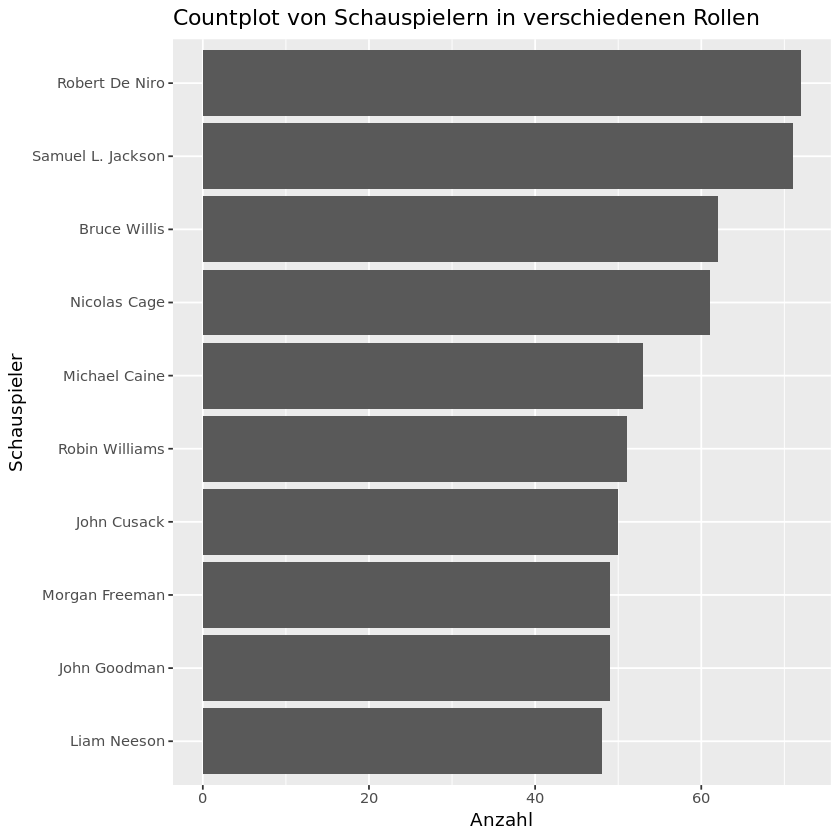

In [20]:
#filtern für am häufigsten vorkommende Schauspieler
df_actors_top10 <- df_actors %>%
    arrange(desc(Freq)) %>%
    head(10) 

# Visualiserung der 10 häufigesten Schauspieler  
ggplot(data=df_actors_top10, aes(x=reorder(v_cast, Freq), y=Freq)) +
geom_bar(stat="identity") +
coord_flip() +
labs(title = "Countplot von Schauspielern in verschiedenen Rollen",
       x = "Schauspieler",
       y = "Anzahl")

Robert De Niro hat mit 72 Besetzungen die meisten Rollen als in Filmen gehabt, dicht gefolgt von Samuel L. Jackson mit einem Film weniger und einem Wert von 71 Besetzungen.

### Welche Filme sind am besten und am schlechtesten bewertet?

Für diese Frage scheinen die Features 'popularity' und 'vote_average' eine gute Basis für die Beantwortung zu bilden, daher werden sie für diese Antwort mithilfe einer einfachen Abfrage verwendet, um als Antwortsätze ausgegeben zu werden.

In [21]:
#Erstellen einer Ausgabe, um die frage zu beantworten
print(paste0("Bester Film nach 'popularity': ", data[data$popularity == max(data$popularity),]$original_title))
print(paste0("Schlechtester Film nach 'popularity': ", data[data$popularity == min(data$popularity),]$original_title))
print(paste0("Bester Film nach 'vote_average': ", data[data$vote_average == max(data$vote_average),]$original_title))
print(paste0("Schlechtester Film nach 'vote_average': ", data[data$vote_average == min(data$vote_average),]$original_title))

[1] "Bester Film nach 'popularity': Jurassic World"
[1] "Schlechtester Film nach 'popularity': North and South, Book I"
[1] "Bester Film nach 'vote_average': The Story of Film: An Odyssey"
[1] "Schlechtester Film nach 'vote_average': Transmorphers"           
[2] "Schlechtester Film nach 'vote_average': Manos: The Hands of Fate"


Es ist zu beobachten, dass anhand von 'popularity' Jurassic World der beste und North and South, Book 1 der schlechteste Film ist. Gemäß dem Feature 'vote_average' wurde The Story of Film: An Odyssey jedoch als bester gewählt, während sich anscheinend zwei Filme den schlechtesten Platz teilen. Dies sind Transmorphers und Manos: The Hands of Fate.

### Gibt es über die Jahrzehnte hinweg Veränderungen in den Laufzeiten der Filme?

Um diese Frage zu beantworten, gibt das Feature 'runtime' einen detaillierten Einblick in die Länge eines Films in Minuten und wird aufgrund dessen an diesem Punkt verwendet, um die Frage zu beantworten.

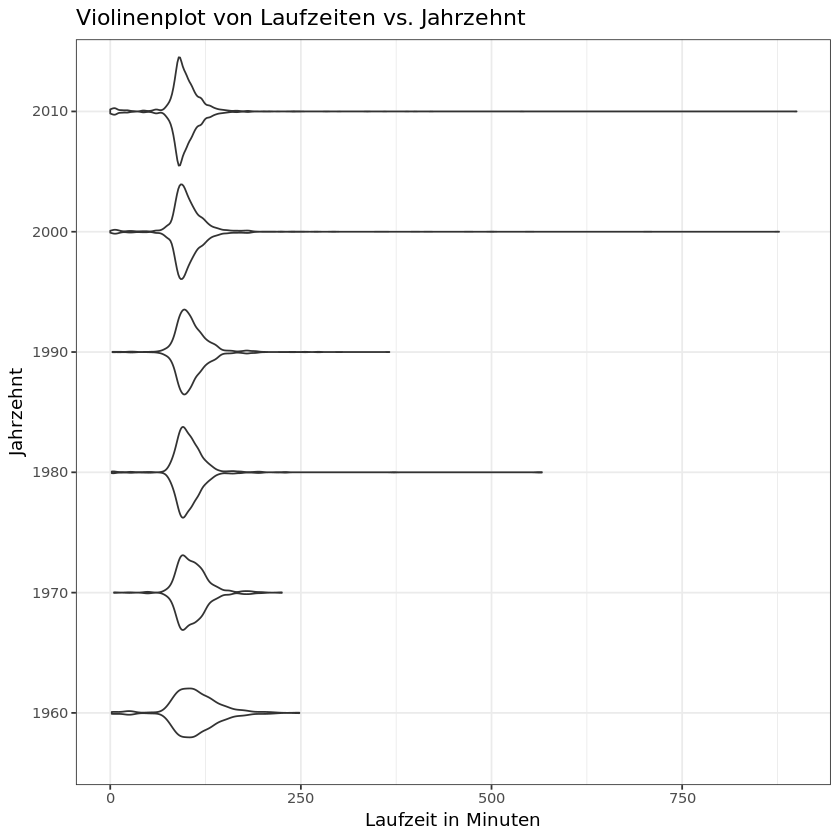

In [22]:
#Erzeuge Violinenplot von Jahrzehnt vs Laufzeit
ggplot(data, aes(factor(decade), runtime)) +
geom_violin() +
coord_flip() +
theme_bw() +
labs(title = "Violinenplot von Laufzeiten vs. Jahrzehnt",
       x = "Jahrzehnt",
       y = "Laufzeit in Minuten")

Was zu beobachten ist, ist, dass sich die Verteilung der Laufzeit im Laufe der Jahrzehnte für den Hauptteil der Filme (beschrieben als annähernd glockenförmige Verteilung) nicht wesentlich geändert zu haben scheint.
Bei Betrachtung der Extremwerte ist jedoch zu bemerken, dass im Laufe des Jahrzehnte immer höhere Laufzeiten auftreten, was zum längsten Film in den Daten des Jahrzehnts 2010 führt.

Weiterführend, wäre es auch interessant zu wissen, welche unterschiedlichen Filme im obigen Violonenplot Ausreißer bilden und zu welchem repräsentativen Genre diese Filme gehören. Zu diesem Zweck werde ich interaktive Diagramme einführen, die auf plotly, einem Java-Framework zur Visualisierung, basieren. Diese Diagramme können interaktiv verwendet werden, um über subsetting eine Teilmenge zu bilden, oder um mit dem Mauszeiger über einzelne Datenpunkte zu hovern, um weitere Informationen zu erhalten. Ab hier soll eine Möglichkeit gegeben werden, eigene Fragen zu stellen und nach Möglichkeit zu versuchen, die Antwort mithilfe dieser Visualisierungen zu herauszuarbeiten.

In [23]:
#Erzeuge Scatterplot von Jahrzehnt vs Laufzeit
p <- data %>%
  plot_ly(x = ~runtime, y = ~decade, color = ~main_genre, text= ~paste("Budget:", budget, "<br>","ROI:", ROI, "<br>", "Name:",  original_title,"<br>", "Year:", release_year)) %>%
  add_markers() %>%
  layout(title = "Scatterplot Jahrzehnt vs Laufzeit")
embed_notebook(p)

Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”

<iframe src="data:text/html;charset=utf-8;base64,PCFET0NUWVBFIGh0bWw+CjxodG1sPgo8aGVhZD4KPG1ldGEgY2hhcnNldD0idXRmLTgiIC8+Cjx0aXRsZT5wbG90bHk8L3RpdGxlPgo8c2NyaXB0PihmdW5jdGlvbigpIHsKICAvLyBJZiB3aW5kb3cuSFRNTFdpZGdldHMgaXMgYWxyZWFkeSBkZWZpbmVkLCB0aGVuIHVzZSBpdDsgb3RoZXJ3aXNlIGNyZWF0ZSBhCiAgLy8gbmV3IG9iamVjdC4gVGhpcyBhbGxvd3MgcHJlY2VkaW5nIGNvZGUgdG8gc2V0IG9wdGlvbnMgdGhhdCBhZmZlY3QgdGhlCiAgLy8gaW5pdGlhbGl6YXRpb24gcHJvY2VzcyAodGhvdWdoIG5vbmUgY3VycmVudGx5IGV4aXN0KS4KICB3aW5kb3cuSFRNTFdpZGdldHMgPSB3aW5kb3cuSFRNTFdpZGdldHMgfHwge307CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIGEgdmlld2VyIHBhbmUuIElmIG5vdCwgd2UncmUgaW4gYSB3ZWIgYnJvd3Nlci4KICB2YXIgdmlld2VyTW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy52aWV3ZXJNb2RlID0KICAgICAgL1xidmlld2VyX3BhbmU9MVxiLy50ZXN0KHdpbmRvdy5sb2NhdGlvbik7CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIFNoaW55IG1vZGUuIElmIG5vdCwgaXQncyBhIHN0YXRpYyBkb2N1bWVudC4KICAvLyBOb3RlIHRoYXQgc3RhdGljIHdpZGdldHMgY2FuIGFwcGVhciBpbiBib3RoIFNoaW55IGFuZCBzdGF0aWMgbW9kZXMsIGJ1dAogIC8vIG9idmlvdXNseSwgU2hpbnkgd2lkZ2V0cyBjYW4gb25seSBhcHBlYXIgaW4gU2hpbnkgYXBwcy9kb2N1bWVudHMuCiAgdmFyIHNoaW55TW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy5zaGlueU1vZGUgPQogICAgICB0eXBlb2Yod2luZG93LlNoaW55KSAhPT0gInVuZGVmaW5lZCIgJiYgISF3aW5kb3cuU2hpbnkub3V0cHV0QmluZGluZ3M7CgogIC8vIFdlIGNhbid0IGNvdW50IG9uIGpRdWVyeSBiZWluZyBhdmFpbGFibGUsIHNvIHdlIGltcGxlbWVudCBvdXIgb3duCiAgLy8gdmVyc2lvbiBpZiBuZWNlc3NhcnkuCiAgZnVuY3Rpb24gcXVlcnlTZWxlY3RvckFsbChzY29wZSwgc2VsZWN0b3IpIHsKICAgIGlmICh0eXBlb2YoalF1ZXJ5KSAhPT0gInVuZGVmaW5lZCIgJiYgc2NvcGUgaW5zdGFuY2VvZiBqUXVlcnkpIHsKICAgICAgcmV0dXJuIHNjb3BlLmZpbmQoc2VsZWN0b3IpOwogICAgfQogICAgaWYgKHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwpIHsKICAgICAgcmV0dXJuIHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwoc2VsZWN0b3IpOwogICAgfQogIH0KCiAgZnVuY3Rpb24gYXNBcnJheSh2YWx1ZSkgewogICAgaWYgKHZhbHVlID09PSBudWxsKQogICAgICByZXR1cm4gW107CiAgICBpZiAoJC5pc0FycmF5KHZhbHVlKSkKICAgICAgcmV0dXJuIHZhbHVlOwogICAgcmV0dXJuIFt2YWx1ZV07CiAgfQoKICAvLyBJbXBsZW1lbnQgalF1ZXJ5J3MgZXh0ZW5kCiAgZnVuY3Rpb24gZXh0ZW5kKHRhcmdldCAvKiwgLi4uICovKSB7CiAgICBpZiAoYXJndW1lbnRzLmxlbmd0aCA9PSAxKSB7CiAgICAgIHJldHVybiB0YXJnZXQ7CiAgICB9CiAgICBmb3IgKHZhciBpID0gMTsgaSA8IGFyZ3VtZW50cy5sZW5ndGg7IGkrKykgewogICAgICB2YXIgc291cmNlID0gYXJndW1lbnRzW2ldOwogICAgICBmb3IgKHZhciBwcm9wIGluIHNvdXJjZSkgewogICAgICAgIGlmIChzb3VyY2UuaGFzT3duUHJvcGVydHkocHJvcCkpIHsKICAgICAgICAgIHRhcmdldFtwcm9wXSA9IHNvdXJjZVtwcm9wXTsKICAgICAgICB9CiAgICAgIH0KICAgIH0KICAgIHJldHVybiB0YXJnZXQ7CiAgfQoKICAvLyBJRTggZG9lc24ndCBzdXBwb3J0IEFycmF5LmZvckVhY2guCiAgZnVuY3Rpb24gZm9yRWFjaCh2YWx1ZXMsIGNhbGxiYWNrLCB0aGlzQXJnKSB7CiAgICBpZiAodmFsdWVzLmZvckVhY2gpIHsKICAgICAgdmFsdWVzLmZvckVhY2goY2FsbGJhY2ssIHRoaXNBcmcpOwogICAgfSBlbHNlIHsKICAgICAgZm9yICh2YXIgaSA9IDA7IGkgPCB2YWx1ZXMubGVuZ3RoOyBpKyspIHsKICAgICAgICBjYWxsYmFjay5jYWxsKHRoaXNBcmcsIHZhbHVlc1tpXSwgaSwgdmFsdWVzKTsKICAgICAgfQogICAgfQogIH0KCiAgLy8gUmVwbGFjZXMgdGhlIHNwZWNpZmllZCBtZXRob2Qgd2l0aCB0aGUgcmV0dXJuIHZhbHVlIG9mIGZ1bmNTb3VyY2UuCiAgLy8KICAvLyBOb3RlIHRoYXQgZnVuY1NvdXJjZSBzaG91bGQgbm90IEJFIHRoZSBuZXcgbWV0aG9kLCBpdCBzaG91bGQgYmUgYSBmdW5jdGlvbgogIC8vIHRoYXQgUkVUVVJOUyB0aGUgbmV3IG1ldGhvZC4gZnVuY1NvdXJjZSByZWNlaXZlcyBhIHNpbmdsZSBhcmd1bWVudCB0aGF0IGlzCiAgLy8gdGhlIG92ZXJyaWRkZW4gbWV0aG9kLCBpdCBjYW4gYmUgY2FsbGVkIGZyb20gdGhlIG5ldyBtZXRob2QuIFRoZSBvdmVycmlkZGVuCiAgLy8gbWV0aG9kIGNhbiBiZSBjYWxsZWQgbGlrZSBhIHJlZ3VsYXIgZnVuY3Rpb24sIGl0IGhhcyB0aGUgdGFyZ2V0IHBlcm1hbmVudGx5CiAgLy8gYm91bmQgdG8gaXQgc28gInRoaXMiIHdpbGwgd29yayBjb3JyZWN0bHkuCiAgZnVuY3Rpb24gb3ZlcnJpZGVNZXRob2QodGFyZ2V0LCBtZXRob2ROYW1lLCBmdW5jU291cmNlKSB7CiAgICB2YXIgc3VwZXJGdW5jID0gdGFyZ2V0W21ldGhvZE5hbWVdIHx8IGZ1bmN0aW9uKCkge307CiAgICB2YXIgc3VwZXJGdW5jQm91bmQgPSBmdW5jdGlvbigpIHsKICAgICAgcmV0dXJuIHN1cGVyRnVuYy5hcHBseSh0YXJnZXQsIGFyZ3VtZW50cyk7CiAgICB9OwogICAgdGFyZ2V0W21ldGhvZE5hbWVdID0gZnVuY1NvdXJjZShzdXBlckZ1bmNCb3VuZCk7CiAgfQoKICAvLyBBZGQgYSBtZXRob2QgdG8gZGVsZWdhdG9yIHRoYXQsIHdoZW4gaW52b2tlZCwgY2FsbHMKICAvLyBkZWxlZ2F0ZWUubWV0aG9kTmFtZS4gSWYgdGhlcmUgaXMgbm8gc3VjaCBtZXRob2Qgb24KICAvLyB0aGUgZGVsZWdhdGVlLCBidXQgdGhlcmUgd2FzIG9uZSBvbiBkZWxlZ2F0b3IgYmVmb3JlCiAgLy8gZGVsZWdhdGVNZXRob2Qgd2FzIGNhbGxlZCwgdGhlbiB

Beim durchschalten der Genres scheinen einige Genres in der Laufzeit länger zu sein als andere. Um dies weiter zu untersuchen, werde ich eine weitere Visualisierung erstellen, die auf durchschnittliche Werten basiert, um zu überprüfen, ob es einen genrespezifischen Unterschied gibt.

In [24]:
#Erzeuge Pipeline für zusammengefasste Daten nach Genre und Jahrezehnt
data_dec <- data %>%
    group_by(main_genre, decade) %>%
    summarize(AVG = mean(runtime))

#Erzeuge Linienplot von Jahrzehnt vs Laufzeit
p <- data.table::melt(na.omit(data_dec), id.vars=c('decade', 'main_genre')) %>%
plot_ly(x = ~decade, y = ~value, name = ~main_genre, color = ~main_genre,  text= ~paste("Genre: ", main_genre, "<br>", "Laufzeit: ",  value)) %>%
    add_lines() %>%
    layout(title = "Linienplot Jahrzehnt vs Laufzeit nach Genre", yaxis = list(title = 'Laufzeit in Minuten'), xaxis = list(title = 'Jahrzehnt'))
embed_notebook(p)

Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”

<iframe src="data:text/html;charset=utf-8;base64,PCFET0NUWVBFIGh0bWw+CjxodG1sPgo8aGVhZD4KPG1ldGEgY2hhcnNldD0idXRmLTgiIC8+Cjx0aXRsZT5wbG90bHk8L3RpdGxlPgo8c2NyaXB0PihmdW5jdGlvbigpIHsKICAvLyBJZiB3aW5kb3cuSFRNTFdpZGdldHMgaXMgYWxyZWFkeSBkZWZpbmVkLCB0aGVuIHVzZSBpdDsgb3RoZXJ3aXNlIGNyZWF0ZSBhCiAgLy8gbmV3IG9iamVjdC4gVGhpcyBhbGxvd3MgcHJlY2VkaW5nIGNvZGUgdG8gc2V0IG9wdGlvbnMgdGhhdCBhZmZlY3QgdGhlCiAgLy8gaW5pdGlhbGl6YXRpb24gcHJvY2VzcyAodGhvdWdoIG5vbmUgY3VycmVudGx5IGV4aXN0KS4KICB3aW5kb3cuSFRNTFdpZGdldHMgPSB3aW5kb3cuSFRNTFdpZGdldHMgfHwge307CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIGEgdmlld2VyIHBhbmUuIElmIG5vdCwgd2UncmUgaW4gYSB3ZWIgYnJvd3Nlci4KICB2YXIgdmlld2VyTW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy52aWV3ZXJNb2RlID0KICAgICAgL1xidmlld2VyX3BhbmU9MVxiLy50ZXN0KHdpbmRvdy5sb2NhdGlvbik7CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIFNoaW55IG1vZGUuIElmIG5vdCwgaXQncyBhIHN0YXRpYyBkb2N1bWVudC4KICAvLyBOb3RlIHRoYXQgc3RhdGljIHdpZGdldHMgY2FuIGFwcGVhciBpbiBib3RoIFNoaW55IGFuZCBzdGF0aWMgbW9kZXMsIGJ1dAogIC8vIG9idmlvdXNseSwgU2hpbnkgd2lkZ2V0cyBjYW4gb25seSBhcHBlYXIgaW4gU2hpbnkgYXBwcy9kb2N1bWVudHMuCiAgdmFyIHNoaW55TW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy5zaGlueU1vZGUgPQogICAgICB0eXBlb2Yod2luZG93LlNoaW55KSAhPT0gInVuZGVmaW5lZCIgJiYgISF3aW5kb3cuU2hpbnkub3V0cHV0QmluZGluZ3M7CgogIC8vIFdlIGNhbid0IGNvdW50IG9uIGpRdWVyeSBiZWluZyBhdmFpbGFibGUsIHNvIHdlIGltcGxlbWVudCBvdXIgb3duCiAgLy8gdmVyc2lvbiBpZiBuZWNlc3NhcnkuCiAgZnVuY3Rpb24gcXVlcnlTZWxlY3RvckFsbChzY29wZSwgc2VsZWN0b3IpIHsKICAgIGlmICh0eXBlb2YoalF1ZXJ5KSAhPT0gInVuZGVmaW5lZCIgJiYgc2NvcGUgaW5zdGFuY2VvZiBqUXVlcnkpIHsKICAgICAgcmV0dXJuIHNjb3BlLmZpbmQoc2VsZWN0b3IpOwogICAgfQogICAgaWYgKHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwpIHsKICAgICAgcmV0dXJuIHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwoc2VsZWN0b3IpOwogICAgfQogIH0KCiAgZnVuY3Rpb24gYXNBcnJheSh2YWx1ZSkgewogICAgaWYgKHZhbHVlID09PSBudWxsKQogICAgICByZXR1cm4gW107CiAgICBpZiAoJC5pc0FycmF5KHZhbHVlKSkKICAgICAgcmV0dXJuIHZhbHVlOwogICAgcmV0dXJuIFt2YWx1ZV07CiAgfQoKICAvLyBJbXBsZW1lbnQgalF1ZXJ5J3MgZXh0ZW5kCiAgZnVuY3Rpb24gZXh0ZW5kKHRhcmdldCAvKiwgLi4uICovKSB7CiAgICBpZiAoYXJndW1lbnRzLmxlbmd0aCA9PSAxKSB7CiAgICAgIHJldHVybiB0YXJnZXQ7CiAgICB9CiAgICBmb3IgKHZhciBpID0gMTsgaSA8IGFyZ3VtZW50cy5sZW5ndGg7IGkrKykgewogICAgICB2YXIgc291cmNlID0gYXJndW1lbnRzW2ldOwogICAgICBmb3IgKHZhciBwcm9wIGluIHNvdXJjZSkgewogICAgICAgIGlmIChzb3VyY2UuaGFzT3duUHJvcGVydHkocHJvcCkpIHsKICAgICAgICAgIHRhcmdldFtwcm9wXSA9IHNvdXJjZVtwcm9wXTsKICAgICAgICB9CiAgICAgIH0KICAgIH0KICAgIHJldHVybiB0YXJnZXQ7CiAgfQoKICAvLyBJRTggZG9lc24ndCBzdXBwb3J0IEFycmF5LmZvckVhY2guCiAgZnVuY3Rpb24gZm9yRWFjaCh2YWx1ZXMsIGNhbGxiYWNrLCB0aGlzQXJnKSB7CiAgICBpZiAodmFsdWVzLmZvckVhY2gpIHsKICAgICAgdmFsdWVzLmZvckVhY2goY2FsbGJhY2ssIHRoaXNBcmcpOwogICAgfSBlbHNlIHsKICAgICAgZm9yICh2YXIgaSA9IDA7IGkgPCB2YWx1ZXMubGVuZ3RoOyBpKyspIHsKICAgICAgICBjYWxsYmFjay5jYWxsKHRoaXNBcmcsIHZhbHVlc1tpXSwgaSwgdmFsdWVzKTsKICAgICAgfQogICAgfQogIH0KCiAgLy8gUmVwbGFjZXMgdGhlIHNwZWNpZmllZCBtZXRob2Qgd2l0aCB0aGUgcmV0dXJuIHZhbHVlIG9mIGZ1bmNTb3VyY2UuCiAgLy8KICAvLyBOb3RlIHRoYXQgZnVuY1NvdXJjZSBzaG91bGQgbm90IEJFIHRoZSBuZXcgbWV0aG9kLCBpdCBzaG91bGQgYmUgYSBmdW5jdGlvbgogIC8vIHRoYXQgUkVUVVJOUyB0aGUgbmV3IG1ldGhvZC4gZnVuY1NvdXJjZSByZWNlaXZlcyBhIHNpbmdsZSBhcmd1bWVudCB0aGF0IGlzCiAgLy8gdGhlIG92ZXJyaWRkZW4gbWV0aG9kLCBpdCBjYW4gYmUgY2FsbGVkIGZyb20gdGhlIG5ldyBtZXRob2QuIFRoZSBvdmVycmlkZGVuCiAgLy8gbWV0aG9kIGNhbiBiZSBjYWxsZWQgbGlrZSBhIHJlZ3VsYXIgZnVuY3Rpb24sIGl0IGhhcyB0aGUgdGFyZ2V0IHBlcm1hbmVudGx5CiAgLy8gYm91bmQgdG8gaXQgc28gInRoaXMiIHdpbGwgd29yayBjb3JyZWN0bHkuCiAgZnVuY3Rpb24gb3ZlcnJpZGVNZXRob2QodGFyZ2V0LCBtZXRob2ROYW1lLCBmdW5jU291cmNlKSB7CiAgICB2YXIgc3VwZXJGdW5jID0gdGFyZ2V0W21ldGhvZE5hbWVdIHx8IGZ1bmN0aW9uKCkge307CiAgICB2YXIgc3VwZXJGdW5jQm91bmQgPSBmdW5jdGlvbigpIHsKICAgICAgcmV0dXJuIHN1cGVyRnVuYy5hcHBseSh0YXJnZXQsIGFyZ3VtZW50cyk7CiAgICB9OwogICAgdGFyZ2V0W21ldGhvZE5hbWVdID0gZnVuY1NvdXJjZShzdXBlckZ1bmNCb3VuZCk7CiAgfQoKICAvLyBBZGQgYSBtZXRob2QgdG8gZGVsZWdhdG9yIHRoYXQsIHdoZW4gaW52b2tlZCwgY2FsbHMKICAvLyBkZWxlZ2F0ZWUubWV0aG9kTmFtZS4gSWYgdGhlcmUgaXMgbm8gc3VjaCBtZXRob2Qgb24KICAvLyB0aGUgZGVsZWdhdGVlLCBidXQgdGhlcmUgd2FzIG9uZSBvbiBkZWxlZ2F0b3IgYmVmb3JlCiAgLy8gZGVsZWdhdGVNZXRob2Qgd2FzIGNhbGxlZCwgdGhlbiB

Wenn man sich die Ergebnisse ansieht, scheint es deutliche Unterschiede in der Laufzeit zu geben, die sich auf das Genre des Films beziehen. Zum Beispiel scheint die Genres Animation und Family im Vergleich zu anderen Filmgenres in der Laufzeit sehr kurz zu sein. Ein ebenfalls interessanter Trend von vielen Genres ist, das obwohl die Filme über die Jahrzehnte längere Laufzeiten zu haben scheinen, resultierend mit dem längesten Film im Jahrzehnt 2010, scheinen generell die durchschnittlichen Laufzeiten besonders im Jahrzehnt 2010 deutlich kürzer als zuvor zu sein.

### Gibt es über die Jahrzehnte hinweg Veränderungen in den Budgets der Filme?

Um diese Frage zu beantworten, werden wir das Feature 'budget' verwenden und die aufgezeichneten Daten über die Jahre ansehen. Da aus den letzten Erkenntnissen ein Unterschied zwischen Genres und über die Jahrehnte hinweg durchaus möglich ist, werde ich direkt die interaktive Variante verwenden, die Einsichten über alle relevantes Aspekte zu dieser Fragestellung liefern kann.

In [25]:
#Erzeuge Scatterplot von popularity vs budget
p <- data[data$budget != 0,] %>%
  plot_ly(x = ~popularity, y = ~budget, color = ~decade, text= ~paste("Umsatz:", revenue, "<br>", "Name:",  original_title,"<br>", "Erscheinungsjahr:", release_year)) %>%
  add_markers() %>%
  layout(title = "Scatterplot popularity vs budget")
embed_notebook(p)

<iframe src="data:text/html;charset=utf-8;base64,PCFET0NUWVBFIGh0bWw+CjxodG1sPgo8aGVhZD4KPG1ldGEgY2hhcnNldD0idXRmLTgiIC8+Cjx0aXRsZT5wbG90bHk8L3RpdGxlPgo8c2NyaXB0PihmdW5jdGlvbigpIHsKICAvLyBJZiB3aW5kb3cuSFRNTFdpZGdldHMgaXMgYWxyZWFkeSBkZWZpbmVkLCB0aGVuIHVzZSBpdDsgb3RoZXJ3aXNlIGNyZWF0ZSBhCiAgLy8gbmV3IG9iamVjdC4gVGhpcyBhbGxvd3MgcHJlY2VkaW5nIGNvZGUgdG8gc2V0IG9wdGlvbnMgdGhhdCBhZmZlY3QgdGhlCiAgLy8gaW5pdGlhbGl6YXRpb24gcHJvY2VzcyAodGhvdWdoIG5vbmUgY3VycmVudGx5IGV4aXN0KS4KICB3aW5kb3cuSFRNTFdpZGdldHMgPSB3aW5kb3cuSFRNTFdpZGdldHMgfHwge307CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIGEgdmlld2VyIHBhbmUuIElmIG5vdCwgd2UncmUgaW4gYSB3ZWIgYnJvd3Nlci4KICB2YXIgdmlld2VyTW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy52aWV3ZXJNb2RlID0KICAgICAgL1xidmlld2VyX3BhbmU9MVxiLy50ZXN0KHdpbmRvdy5sb2NhdGlvbik7CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIFNoaW55IG1vZGUuIElmIG5vdCwgaXQncyBhIHN0YXRpYyBkb2N1bWVudC4KICAvLyBOb3RlIHRoYXQgc3RhdGljIHdpZGdldHMgY2FuIGFwcGVhciBpbiBib3RoIFNoaW55IGFuZCBzdGF0aWMgbW9kZXMsIGJ1dAogIC8vIG9idmlvdXNseSwgU2hpbnkgd2lkZ2V0cyBjYW4gb25seSBhcHBlYXIgaW4gU2hpbnkgYXBwcy9kb2N1bWVudHMuCiAgdmFyIHNoaW55TW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy5zaGlueU1vZGUgPQogICAgICB0eXBlb2Yod2luZG93LlNoaW55KSAhPT0gInVuZGVmaW5lZCIgJiYgISF3aW5kb3cuU2hpbnkub3V0cHV0QmluZGluZ3M7CgogIC8vIFdlIGNhbid0IGNvdW50IG9uIGpRdWVyeSBiZWluZyBhdmFpbGFibGUsIHNvIHdlIGltcGxlbWVudCBvdXIgb3duCiAgLy8gdmVyc2lvbiBpZiBuZWNlc3NhcnkuCiAgZnVuY3Rpb24gcXVlcnlTZWxlY3RvckFsbChzY29wZSwgc2VsZWN0b3IpIHsKICAgIGlmICh0eXBlb2YoalF1ZXJ5KSAhPT0gInVuZGVmaW5lZCIgJiYgc2NvcGUgaW5zdGFuY2VvZiBqUXVlcnkpIHsKICAgICAgcmV0dXJuIHNjb3BlLmZpbmQoc2VsZWN0b3IpOwogICAgfQogICAgaWYgKHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwpIHsKICAgICAgcmV0dXJuIHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwoc2VsZWN0b3IpOwogICAgfQogIH0KCiAgZnVuY3Rpb24gYXNBcnJheSh2YWx1ZSkgewogICAgaWYgKHZhbHVlID09PSBudWxsKQogICAgICByZXR1cm4gW107CiAgICBpZiAoJC5pc0FycmF5KHZhbHVlKSkKICAgICAgcmV0dXJuIHZhbHVlOwogICAgcmV0dXJuIFt2YWx1ZV07CiAgfQoKICAvLyBJbXBsZW1lbnQgalF1ZXJ5J3MgZXh0ZW5kCiAgZnVuY3Rpb24gZXh0ZW5kKHRhcmdldCAvKiwgLi4uICovKSB7CiAgICBpZiAoYXJndW1lbnRzLmxlbmd0aCA9PSAxKSB7CiAgICAgIHJldHVybiB0YXJnZXQ7CiAgICB9CiAgICBmb3IgKHZhciBpID0gMTsgaSA8IGFyZ3VtZW50cy5sZW5ndGg7IGkrKykgewogICAgICB2YXIgc291cmNlID0gYXJndW1lbnRzW2ldOwogICAgICBmb3IgKHZhciBwcm9wIGluIHNvdXJjZSkgewogICAgICAgIGlmIChzb3VyY2UuaGFzT3duUHJvcGVydHkocHJvcCkpIHsKICAgICAgICAgIHRhcmdldFtwcm9wXSA9IHNvdXJjZVtwcm9wXTsKICAgICAgICB9CiAgICAgIH0KICAgIH0KICAgIHJldHVybiB0YXJnZXQ7CiAgfQoKICAvLyBJRTggZG9lc24ndCBzdXBwb3J0IEFycmF5LmZvckVhY2guCiAgZnVuY3Rpb24gZm9yRWFjaCh2YWx1ZXMsIGNhbGxiYWNrLCB0aGlzQXJnKSB7CiAgICBpZiAodmFsdWVzLmZvckVhY2gpIHsKICAgICAgdmFsdWVzLmZvckVhY2goY2FsbGJhY2ssIHRoaXNBcmcpOwogICAgfSBlbHNlIHsKICAgICAgZm9yICh2YXIgaSA9IDA7IGkgPCB2YWx1ZXMubGVuZ3RoOyBpKyspIHsKICAgICAgICBjYWxsYmFjay5jYWxsKHRoaXNBcmcsIHZhbHVlc1tpXSwgaSwgdmFsdWVzKTsKICAgICAgfQogICAgfQogIH0KCiAgLy8gUmVwbGFjZXMgdGhlIHNwZWNpZmllZCBtZXRob2Qgd2l0aCB0aGUgcmV0dXJuIHZhbHVlIG9mIGZ1bmNTb3VyY2UuCiAgLy8KICAvLyBOb3RlIHRoYXQgZnVuY1NvdXJjZSBzaG91bGQgbm90IEJFIHRoZSBuZXcgbWV0aG9kLCBpdCBzaG91bGQgYmUgYSBmdW5jdGlvbgogIC8vIHRoYXQgUkVUVVJOUyB0aGUgbmV3IG1ldGhvZC4gZnVuY1NvdXJjZSByZWNlaXZlcyBhIHNpbmdsZSBhcmd1bWVudCB0aGF0IGlzCiAgLy8gdGhlIG92ZXJyaWRkZW4gbWV0aG9kLCBpdCBjYW4gYmUgY2FsbGVkIGZyb20gdGhlIG5ldyBtZXRob2QuIFRoZSBvdmVycmlkZGVuCiAgLy8gbWV0aG9kIGNhbiBiZSBjYWxsZWQgbGlrZSBhIHJlZ3VsYXIgZnVuY3Rpb24sIGl0IGhhcyB0aGUgdGFyZ2V0IHBlcm1hbmVudGx5CiAgLy8gYm91bmQgdG8gaXQgc28gInRoaXMiIHdpbGwgd29yayBjb3JyZWN0bHkuCiAgZnVuY3Rpb24gb3ZlcnJpZGVNZXRob2QodGFyZ2V0LCBtZXRob2ROYW1lLCBmdW5jU291cmNlKSB7CiAgICB2YXIgc3VwZXJGdW5jID0gdGFyZ2V0W21ldGhvZE5hbWVdIHx8IGZ1bmN0aW9uKCkge307CiAgICB2YXIgc3VwZXJGdW5jQm91bmQgPSBmdW5jdGlvbigpIHsKICAgICAgcmV0dXJuIHN1cGVyRnVuYy5hcHBseSh0YXJnZXQsIGFyZ3VtZW50cyk7CiAgICB9OwogICAgdGFyZ2V0W21ldGhvZE5hbWVdID0gZnVuY1NvdXJjZShzdXBlckZ1bmNCb3VuZCk7CiAgfQoKICAvLyBBZGQgYSBtZXRob2QgdG8gZGVsZWdhdG9yIHRoYXQsIHdoZW4gaW52b2tlZCwgY2FsbHMKICAvLyBkZWxlZ2F0ZWUubWV0aG9kTmFtZS4gSWYgdGhlcmUgaXMgbm8gc3VjaCBtZXRob2Qgb24KICAvLyB0aGUgZGVsZWdhdGVlLCBidXQgdGhlcmUgd2FzIG9uZSBvbiBkZWxlZ2F0b3IgYmVmb3JlCiAgLy8gZGVsZWdhdGVNZXRob2Qgd2FzIGNhbGxlZCwgdGhlbiB

Zunächst fällt auf, dass sich anscheinend das verwendete Budget genreunabhängig über die letzten 50 Jahre vervielfacht hat. Beim Durchblättern verschiedener Genres scheint hier ein klares Muster zu bestehen, dass das durchschnittliche verwendete Budget mit den Jahrzehnten in den 60er Jahren bei etwa 5-10 Millionen begann, zu steigen scheint und in den 2010er Jahren fast 20-fache Werte im Bereich von 20-55 Millionen erreicht. 

Das Genre mit dem meisten Budget ist Adventure in 2010 mit durchschnittlich fast 100 Millionen pro Film. 

Ein ebenfalls interessanter Trend mancher Genres ist ein signifikanter Anstieg des Budgets ab 1980 oder 1990 gefolgt von einem Abstieg des durchschnittlichen Bugdets von 2000 auf 2010, so kann man für Western, Family und History diesen Trend beobachten.

In [26]:
#Erzeuge Pipeline für zusammengefasste Daten nach Genre und Jahrezehnt
data_dec <- data[data$budget != 0,] %>%
    group_by(main_genre, decade) %>%
    summarize(AVG = mean(budget))

#Erzeuge Linienplot von Budget über Jahrzehnte
p <- data.table::melt(na.omit(data_dec), id.vars=c('decade', 'main_genre')) %>%
plot_ly(x = ~decade, y = ~value, name = ~main_genre, color = ~main_genre,  text= ~paste("Genre: ", main_genre, "<br>", "Budget: ",  value)) %>%
    add_lines() %>%
    layout(title = "Linienplot von Budget vs Jahrzehnte nach Genres", yaxis = list(title = 'Budget'))
embed_notebook(p)

Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”

<iframe src="data:text/html;charset=utf-8;base64,PCFET0NUWVBFIGh0bWw+CjxodG1sPgo8aGVhZD4KPG1ldGEgY2hhcnNldD0idXRmLTgiIC8+Cjx0aXRsZT5wbG90bHk8L3RpdGxlPgo8c2NyaXB0PihmdW5jdGlvbigpIHsKICAvLyBJZiB3aW5kb3cuSFRNTFdpZGdldHMgaXMgYWxyZWFkeSBkZWZpbmVkLCB0aGVuIHVzZSBpdDsgb3RoZXJ3aXNlIGNyZWF0ZSBhCiAgLy8gbmV3IG9iamVjdC4gVGhpcyBhbGxvd3MgcHJlY2VkaW5nIGNvZGUgdG8gc2V0IG9wdGlvbnMgdGhhdCBhZmZlY3QgdGhlCiAgLy8gaW5pdGlhbGl6YXRpb24gcHJvY2VzcyAodGhvdWdoIG5vbmUgY3VycmVudGx5IGV4aXN0KS4KICB3aW5kb3cuSFRNTFdpZGdldHMgPSB3aW5kb3cuSFRNTFdpZGdldHMgfHwge307CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIGEgdmlld2VyIHBhbmUuIElmIG5vdCwgd2UncmUgaW4gYSB3ZWIgYnJvd3Nlci4KICB2YXIgdmlld2VyTW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy52aWV3ZXJNb2RlID0KICAgICAgL1xidmlld2VyX3BhbmU9MVxiLy50ZXN0KHdpbmRvdy5sb2NhdGlvbik7CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIFNoaW55IG1vZGUuIElmIG5vdCwgaXQncyBhIHN0YXRpYyBkb2N1bWVudC4KICAvLyBOb3RlIHRoYXQgc3RhdGljIHdpZGdldHMgY2FuIGFwcGVhciBpbiBib3RoIFNoaW55IGFuZCBzdGF0aWMgbW9kZXMsIGJ1dAogIC8vIG9idmlvdXNseSwgU2hpbnkgd2lkZ2V0cyBjYW4gb25seSBhcHBlYXIgaW4gU2hpbnkgYXBwcy9kb2N1bWVudHMuCiAgdmFyIHNoaW55TW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy5zaGlueU1vZGUgPQogICAgICB0eXBlb2Yod2luZG93LlNoaW55KSAhPT0gInVuZGVmaW5lZCIgJiYgISF3aW5kb3cuU2hpbnkub3V0cHV0QmluZGluZ3M7CgogIC8vIFdlIGNhbid0IGNvdW50IG9uIGpRdWVyeSBiZWluZyBhdmFpbGFibGUsIHNvIHdlIGltcGxlbWVudCBvdXIgb3duCiAgLy8gdmVyc2lvbiBpZiBuZWNlc3NhcnkuCiAgZnVuY3Rpb24gcXVlcnlTZWxlY3RvckFsbChzY29wZSwgc2VsZWN0b3IpIHsKICAgIGlmICh0eXBlb2YoalF1ZXJ5KSAhPT0gInVuZGVmaW5lZCIgJiYgc2NvcGUgaW5zdGFuY2VvZiBqUXVlcnkpIHsKICAgICAgcmV0dXJuIHNjb3BlLmZpbmQoc2VsZWN0b3IpOwogICAgfQogICAgaWYgKHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwpIHsKICAgICAgcmV0dXJuIHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwoc2VsZWN0b3IpOwogICAgfQogIH0KCiAgZnVuY3Rpb24gYXNBcnJheSh2YWx1ZSkgewogICAgaWYgKHZhbHVlID09PSBudWxsKQogICAgICByZXR1cm4gW107CiAgICBpZiAoJC5pc0FycmF5KHZhbHVlKSkKICAgICAgcmV0dXJuIHZhbHVlOwogICAgcmV0dXJuIFt2YWx1ZV07CiAgfQoKICAvLyBJbXBsZW1lbnQgalF1ZXJ5J3MgZXh0ZW5kCiAgZnVuY3Rpb24gZXh0ZW5kKHRhcmdldCAvKiwgLi4uICovKSB7CiAgICBpZiAoYXJndW1lbnRzLmxlbmd0aCA9PSAxKSB7CiAgICAgIHJldHVybiB0YXJnZXQ7CiAgICB9CiAgICBmb3IgKHZhciBpID0gMTsgaSA8IGFyZ3VtZW50cy5sZW5ndGg7IGkrKykgewogICAgICB2YXIgc291cmNlID0gYXJndW1lbnRzW2ldOwogICAgICBmb3IgKHZhciBwcm9wIGluIHNvdXJjZSkgewogICAgICAgIGlmIChzb3VyY2UuaGFzT3duUHJvcGVydHkocHJvcCkpIHsKICAgICAgICAgIHRhcmdldFtwcm9wXSA9IHNvdXJjZVtwcm9wXTsKICAgICAgICB9CiAgICAgIH0KICAgIH0KICAgIHJldHVybiB0YXJnZXQ7CiAgfQoKICAvLyBJRTggZG9lc24ndCBzdXBwb3J0IEFycmF5LmZvckVhY2guCiAgZnVuY3Rpb24gZm9yRWFjaCh2YWx1ZXMsIGNhbGxiYWNrLCB0aGlzQXJnKSB7CiAgICBpZiAodmFsdWVzLmZvckVhY2gpIHsKICAgICAgdmFsdWVzLmZvckVhY2goY2FsbGJhY2ssIHRoaXNBcmcpOwogICAgfSBlbHNlIHsKICAgICAgZm9yICh2YXIgaSA9IDA7IGkgPCB2YWx1ZXMubGVuZ3RoOyBpKyspIHsKICAgICAgICBjYWxsYmFjay5jYWxsKHRoaXNBcmcsIHZhbHVlc1tpXSwgaSwgdmFsdWVzKTsKICAgICAgfQogICAgfQogIH0KCiAgLy8gUmVwbGFjZXMgdGhlIHNwZWNpZmllZCBtZXRob2Qgd2l0aCB0aGUgcmV0dXJuIHZhbHVlIG9mIGZ1bmNTb3VyY2UuCiAgLy8KICAvLyBOb3RlIHRoYXQgZnVuY1NvdXJjZSBzaG91bGQgbm90IEJFIHRoZSBuZXcgbWV0aG9kLCBpdCBzaG91bGQgYmUgYSBmdW5jdGlvbgogIC8vIHRoYXQgUkVUVVJOUyB0aGUgbmV3IG1ldGhvZC4gZnVuY1NvdXJjZSByZWNlaXZlcyBhIHNpbmdsZSBhcmd1bWVudCB0aGF0IGlzCiAgLy8gdGhlIG92ZXJyaWRkZW4gbWV0aG9kLCBpdCBjYW4gYmUgY2FsbGVkIGZyb20gdGhlIG5ldyBtZXRob2QuIFRoZSBvdmVycmlkZGVuCiAgLy8gbWV0aG9kIGNhbiBiZSBjYWxsZWQgbGlrZSBhIHJlZ3VsYXIgZnVuY3Rpb24sIGl0IGhhcyB0aGUgdGFyZ2V0IHBlcm1hbmVudGx5CiAgLy8gYm91bmQgdG8gaXQgc28gInRoaXMiIHdpbGwgd29yayBjb3JyZWN0bHkuCiAgZnVuY3Rpb24gb3ZlcnJpZGVNZXRob2QodGFyZ2V0LCBtZXRob2ROYW1lLCBmdW5jU291cmNlKSB7CiAgICB2YXIgc3VwZXJGdW5jID0gdGFyZ2V0W21ldGhvZE5hbWVdIHx8IGZ1bmN0aW9uKCkge307CiAgICB2YXIgc3VwZXJGdW5jQm91bmQgPSBmdW5jdGlvbigpIHsKICAgICAgcmV0dXJuIHN1cGVyRnVuYy5hcHBseSh0YXJnZXQsIGFyZ3VtZW50cyk7CiAgICB9OwogICAgdGFyZ2V0W21ldGhvZE5hbWVdID0gZnVuY1NvdXJjZShzdXBlckZ1bmNCb3VuZCk7CiAgfQoKICAvLyBBZGQgYSBtZXRob2QgdG8gZGVsZWdhdG9yIHRoYXQsIHdoZW4gaW52b2tlZCwgY2FsbHMKICAvLyBkZWxlZ2F0ZWUubWV0aG9kTmFtZS4gSWYgdGhlcmUgaXMgbm8gc3VjaCBtZXRob2Qgb24KICAvLyB0aGUgZGVsZWdhdGVlLCBidXQgdGhlcmUgd2FzIG9uZSBvbiBkZWxlZ2F0b3IgYmVmb3JlCiAgLy8gZGVsZWdhdGVNZXRob2Qgd2FzIGNhbGxlZCwgdGhlbiB

### Gibt es über die Jahrzehnte hinweg Veränderungen in den Genrefrequenz der Filme?

Um diese Frage zu beantworten, werde ich anhand des features main_genre eine Querypipeline generieren, die einen Überblick generiert, der nach Jahrzehnten gruppiert ist und Einblick in die Anzahl bestimmter Genres gibt.

In [27]:
#Erzeuge Pipeline für zusammengefasste Daten nach Genre und Jahrzehnt für Genrefrequenzen
data_dec <- data %>%
    group_by(decade) %>%
    mutate(num_decade = n()) %>%
    group_by(decade,main_genre) %>%
    mutate(num_decade_genre = n()) %>%
    summarize(freq_decade_genre = mean(num_decade_genre/num_decade))

#Erzeuge Linienplot von relativen Genrefrequenzen über Jahrzehnte
p <- data.table::melt(data_dec, id.vars=c('decade', 'main_genre')) %>%
plot_ly(x = ~decade, y = ~value, name = ~main_genre, color = ~main_genre,  text= ~paste("Genre: ", main_genre, "<br>", "Prozent:",  (value*100))) %>%
    add_lines() %>%
    layout(title = "Linienplot von relativen Genrefrequenzen vs Jahrzehnte", yaxis = list(title = 'Prozent'))
embed_notebook(p)

Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”Warning message in RColorBrewer::brewer.pal(N, "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”

<iframe src="data:text/html;charset=utf-8;base64,PCFET0NUWVBFIGh0bWw+CjxodG1sPgo8aGVhZD4KPG1ldGEgY2hhcnNldD0idXRmLTgiIC8+Cjx0aXRsZT5wbG90bHk8L3RpdGxlPgo8c2NyaXB0PihmdW5jdGlvbigpIHsKICAvLyBJZiB3aW5kb3cuSFRNTFdpZGdldHMgaXMgYWxyZWFkeSBkZWZpbmVkLCB0aGVuIHVzZSBpdDsgb3RoZXJ3aXNlIGNyZWF0ZSBhCiAgLy8gbmV3IG9iamVjdC4gVGhpcyBhbGxvd3MgcHJlY2VkaW5nIGNvZGUgdG8gc2V0IG9wdGlvbnMgdGhhdCBhZmZlY3QgdGhlCiAgLy8gaW5pdGlhbGl6YXRpb24gcHJvY2VzcyAodGhvdWdoIG5vbmUgY3VycmVudGx5IGV4aXN0KS4KICB3aW5kb3cuSFRNTFdpZGdldHMgPSB3aW5kb3cuSFRNTFdpZGdldHMgfHwge307CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIGEgdmlld2VyIHBhbmUuIElmIG5vdCwgd2UncmUgaW4gYSB3ZWIgYnJvd3Nlci4KICB2YXIgdmlld2VyTW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy52aWV3ZXJNb2RlID0KICAgICAgL1xidmlld2VyX3BhbmU9MVxiLy50ZXN0KHdpbmRvdy5sb2NhdGlvbik7CgogIC8vIFNlZSBpZiB3ZSdyZSBydW5uaW5nIGluIFNoaW55IG1vZGUuIElmIG5vdCwgaXQncyBhIHN0YXRpYyBkb2N1bWVudC4KICAvLyBOb3RlIHRoYXQgc3RhdGljIHdpZGdldHMgY2FuIGFwcGVhciBpbiBib3RoIFNoaW55IGFuZCBzdGF0aWMgbW9kZXMsIGJ1dAogIC8vIG9idmlvdXNseSwgU2hpbnkgd2lkZ2V0cyBjYW4gb25seSBhcHBlYXIgaW4gU2hpbnkgYXBwcy9kb2N1bWVudHMuCiAgdmFyIHNoaW55TW9kZSA9IHdpbmRvdy5IVE1MV2lkZ2V0cy5zaGlueU1vZGUgPQogICAgICB0eXBlb2Yod2luZG93LlNoaW55KSAhPT0gInVuZGVmaW5lZCIgJiYgISF3aW5kb3cuU2hpbnkub3V0cHV0QmluZGluZ3M7CgogIC8vIFdlIGNhbid0IGNvdW50IG9uIGpRdWVyeSBiZWluZyBhdmFpbGFibGUsIHNvIHdlIGltcGxlbWVudCBvdXIgb3duCiAgLy8gdmVyc2lvbiBpZiBuZWNlc3NhcnkuCiAgZnVuY3Rpb24gcXVlcnlTZWxlY3RvckFsbChzY29wZSwgc2VsZWN0b3IpIHsKICAgIGlmICh0eXBlb2YoalF1ZXJ5KSAhPT0gInVuZGVmaW5lZCIgJiYgc2NvcGUgaW5zdGFuY2VvZiBqUXVlcnkpIHsKICAgICAgcmV0dXJuIHNjb3BlLmZpbmQoc2VsZWN0b3IpOwogICAgfQogICAgaWYgKHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwpIHsKICAgICAgcmV0dXJuIHNjb3BlLnF1ZXJ5U2VsZWN0b3JBbGwoc2VsZWN0b3IpOwogICAgfQogIH0KCiAgZnVuY3Rpb24gYXNBcnJheSh2YWx1ZSkgewogICAgaWYgKHZhbHVlID09PSBudWxsKQogICAgICByZXR1cm4gW107CiAgICBpZiAoJC5pc0FycmF5KHZhbHVlKSkKICAgICAgcmV0dXJuIHZhbHVlOwogICAgcmV0dXJuIFt2YWx1ZV07CiAgfQoKICAvLyBJbXBsZW1lbnQgalF1ZXJ5J3MgZXh0ZW5kCiAgZnVuY3Rpb24gZXh0ZW5kKHRhcmdldCAvKiwgLi4uICovKSB7CiAgICBpZiAoYXJndW1lbnRzLmxlbmd0aCA9PSAxKSB7CiAgICAgIHJldHVybiB0YXJnZXQ7CiAgICB9CiAgICBmb3IgKHZhciBpID0gMTsgaSA8IGFyZ3VtZW50cy5sZW5ndGg7IGkrKykgewogICAgICB2YXIgc291cmNlID0gYXJndW1lbnRzW2ldOwogICAgICBmb3IgKHZhciBwcm9wIGluIHNvdXJjZSkgewogICAgICAgIGlmIChzb3VyY2UuaGFzT3duUHJvcGVydHkocHJvcCkpIHsKICAgICAgICAgIHRhcmdldFtwcm9wXSA9IHNvdXJjZVtwcm9wXTsKICAgICAgICB9CiAgICAgIH0KICAgIH0KICAgIHJldHVybiB0YXJnZXQ7CiAgfQoKICAvLyBJRTggZG9lc24ndCBzdXBwb3J0IEFycmF5LmZvckVhY2guCiAgZnVuY3Rpb24gZm9yRWFjaCh2YWx1ZXMsIGNhbGxiYWNrLCB0aGlzQXJnKSB7CiAgICBpZiAodmFsdWVzLmZvckVhY2gpIHsKICAgICAgdmFsdWVzLmZvckVhY2goY2FsbGJhY2ssIHRoaXNBcmcpOwogICAgfSBlbHNlIHsKICAgICAgZm9yICh2YXIgaSA9IDA7IGkgPCB2YWx1ZXMubGVuZ3RoOyBpKyspIHsKICAgICAgICBjYWxsYmFjay5jYWxsKHRoaXNBcmcsIHZhbHVlc1tpXSwgaSwgdmFsdWVzKTsKICAgICAgfQogICAgfQogIH0KCiAgLy8gUmVwbGFjZXMgdGhlIHNwZWNpZmllZCBtZXRob2Qgd2l0aCB0aGUgcmV0dXJuIHZhbHVlIG9mIGZ1bmNTb3VyY2UuCiAgLy8KICAvLyBOb3RlIHRoYXQgZnVuY1NvdXJjZSBzaG91bGQgbm90IEJFIHRoZSBuZXcgbWV0aG9kLCBpdCBzaG91bGQgYmUgYSBmdW5jdGlvbgogIC8vIHRoYXQgUkVUVVJOUyB0aGUgbmV3IG1ldGhvZC4gZnVuY1NvdXJjZSByZWNlaXZlcyBhIHNpbmdsZSBhcmd1bWVudCB0aGF0IGlzCiAgLy8gdGhlIG92ZXJyaWRkZW4gbWV0aG9kLCBpdCBjYW4gYmUgY2FsbGVkIGZyb20gdGhlIG5ldyBtZXRob2QuIFRoZSBvdmVycmlkZGVuCiAgLy8gbWV0aG9kIGNhbiBiZSBjYWxsZWQgbGlrZSBhIHJlZ3VsYXIgZnVuY3Rpb24sIGl0IGhhcyB0aGUgdGFyZ2V0IHBlcm1hbmVudGx5CiAgLy8gYm91bmQgdG8gaXQgc28gInRoaXMiIHdpbGwgd29yayBjb3JyZWN0bHkuCiAgZnVuY3Rpb24gb3ZlcnJpZGVNZXRob2QodGFyZ2V0LCBtZXRob2ROYW1lLCBmdW5jU291cmNlKSB7CiAgICB2YXIgc3VwZXJGdW5jID0gdGFyZ2V0W21ldGhvZE5hbWVdIHx8IGZ1bmN0aW9uKCkge307CiAgICB2YXIgc3VwZXJGdW5jQm91bmQgPSBmdW5jdGlvbigpIHsKICAgICAgcmV0dXJuIHN1cGVyRnVuYy5hcHBseSh0YXJnZXQsIGFyZ3VtZW50cyk7CiAgICB9OwogICAgdGFyZ2V0W21ldGhvZE5hbWVdID0gZnVuY1NvdXJjZShzdXBlckZ1bmNCb3VuZCk7CiAgfQoKICAvLyBBZGQgYSBtZXRob2QgdG8gZGVsZWdhdG9yIHRoYXQsIHdoZW4gaW52b2tlZCwgY2FsbHMKICAvLyBkZWxlZ2F0ZWUubWV0aG9kTmFtZS4gSWYgdGhlcmUgaXMgbm8gc3VjaCBtZXRob2Qgb24KICAvLyB0aGUgZGVsZWdhdGVlLCBidXQgdGhlcmUgd2FzIG9uZSBvbiBkZWxlZ2F0b3IgYmVmb3JlCiAgLy8gZGVsZWdhdGVNZXRob2Qgd2FzIGNhbGxlZCwgdGhlbiB

Auffällig an diesem Punkt ist, dass es eine über die Jahrzehnte sehr prägante Genres gibt. Diese sind Comedy, Drama und Action mit einem durschnittlichen anteil von jeweils 15-20% ca die Hälfte der Anteile von vorhandenen Filmgenres einnehmen.
Weiterhin auffällig ist, dass Horror in den 90ern im vergleich zu anderen Jahrzehnten eine tiefphase hatte und sich seitdem  erholt hat. Der höchste bisherige Anteil lässt sich über 3 Jahrzehnte hinweg dem Genre Comedy zuweisen, mit einem ungefähren gesamtanteil von 25%.

Weiterhin sich auf die prozentual geringer ausfallenden Genres eingehend, zeigt sich, dass die Genres Documentary und Thriller in den letzten beiden Jahrehnten einen sehr starken Anstieg zu verzeichnen haben. Entgegengesetzt scheint Crime über die Jahre hinweg in dem relativen Anteil weitergehen geringer zu werden.

 <a id='conclusions'></a>
## Zusammenfassung

In diesem Notebook habe ich eine Datenanalyse gemäß dem CRISP-DM Prozess durchgeführt. Die folgenden Einsichten sind die von mir konsolidierten Ergebnisse, zusammengefast nach Fragestellungen:

- Welche Schauspieler haben in den meisten Filmen mitgewirkt?
    - Robert De Niro: 72 Besetzungen
    - Samuel L. Jackson: 71 Besetzungen
    - Bruce Willis: 62 Besetzungen


- Welche Filme sind am besten und am schlechtesten bewertet?
    - Jurassic World ist der bestbewertete Film gemäß dem Feature 'popularity'
    - North and South, Book I ist der am schlechtesten bewertete Film gemäß dem Feature 'popularity'
    - The Story of Film: An Odyssey ist der bestbewertete Film gemäß dem Feature 'vote_average'
    - Transmorphers und Manos: The Hands of Fate sind die am schlechtesten bewerteten Filme gemäß dem Feature 'vote_average'
   
   
- Gibt es über die Jahrzehnte hinweg Veränderungen in den Laufzeiten der Filme?
    - Die Laufzeiten des Hauptanteils der Filme nicht wesentlich geändert 
    - Extremwerte sind im Laufe der Jahrzehnte immer höher geworden
        - Längster Film im Jahrzehnt 2010
    - Genrespezifische Unterschiede in Filmlaufzeiten:
         - Animation und Family sehr kurz im Vergleich zu anderen Genres
    - Filme scheinen im Laufe der Zeit durchschnittlich kürzere Laufzeiten zu haben  


- Gibt es über die Jahrzehnte hinweg Veränderungen in den Budgets der Filme?
    - genereller Trend: Budget verfielfacht
        - durchschnittliches Budget in dern 60ern: 5-10 Millionen
        - durchschnittliches Budget in dern 10ern: 20-55 Millionen
    - all-time high an verwendetem Budget: Adventure; 10er
    - Abstieg von Western, Family und History ab 2000


- Gibt es über die Jahrzehnte hinweg Veränderungen in den Genrefrequenz der Filme?
    - größter Anteil der Genres über alle Jahrzehnte hinweg: Comedy, Drama und Action
        - Comedy prozentual gesehen häufigstes vorkommendes Genre
    - Horror hat signifikante Tiefphase in den 90ern
    - starker Anstieg der Genres Documentary und Thriller
    - starler Abstieg des Genres Crime


<a id='conclusions2'></a>   
## Schlusswort

Abschließend möchte ich auf potentielle Schwächen und andere Dinge eingehen, die auf die Validität meiner erzeugten Einsichten Einfluss nehmen. Zunächst wird über alle Filme generalisierend eien Aussage, basierend aud diesem Datenset gemacht. Allerdings scheint dieses Datenset mit 10.866 Filmen nur einen Bruchteil aller produzierten Filme zu enthalten. Schätzungen zufolge existieren etwas 500.000 Filme, was ein bekannt-unbekannt Verhältnis von ca 1:50 bedeuten würde. Basierend auf dieser Annahme sind die von mir erzeugten Einsichten zu Hinterfragen.<sup>20</sup>

<a id='literature'></a>
## Literaturverzeichnis

[1] : tmbd movies dataset; abgerufen am 31.05.2020 von https://www.kaggle.com/juzershakir/tmdb-movies-dataset

[2] : Chapman, P., Clinton, J., Kerber, R., Khabaza, T., Reinartz, T., Shearer, C.R., & Wirth, R. (2000). CRISP-DM 1.0: Step-by-step data mining guide.; S1

[3,4,5,6,7,8] : Chapman, P., Clinton, J., Kerber, R., Khabaza, T., Reinartz, T., Shearer, C.R., & Wirth, R. (2000). CRISP-DM 1.0: Step-by-step data mining guide.; S10-S11

[9] : dplyr; abgerufen am 31.05.2020 von https://cran.r-project.org/web/packages/dplyr/dplyr.pdf

[10] : naniar; abgerufen am 31.05.2020 von https://cran.r-project.org/web/packages/naniar/naniar.pdf

[11] : ggplot2; abgerufen am 31.05.2020 von https://cran.r-project.org/web/packages/ggplot2/ggplot2.pdf

[12] : tidyr; abgerufen am 31.05.2020 von https://cran.r-project.org/web/packages/tidyr/tidyr.pdf

[13] : readr; abgerufen am 31.05.2020 von https://cran.r-project.org/web/packages/readr/readr.pdf

[14] : plotly; abgerufen am 31.05.2020 von https://cran.r-project.org/web/packages/plotly/plotly.pdf

[15] : naniar; abgerufen am 31.05.2020 von https://cran.r-project.org/web/packages/naniar/naniar.pdf

[16] : visdat; abgerufen am 31.05.2020 von https://cran.r-project.org/web/packages/visdat/visdat.pdf

[17] : lubridate; abgerufen am 31.05.2020 von https://cran.r-project.org/web/packages/lubridate/lubridate.pdf

[18] : openair; abgerufen am 31.05.2020 von https://cran.r-project.org/web/packages/openair/openair.pdf

[19] : data.table; abgerufen am 31.05.2020 von https://cran.r-project.org/web/packages/data.table/data.table.pdf

[20] : geschätzte Zahl aller Filme; abgerufen am 31.05.2020 von https://www.google.com/search?q=how+many+movies+have+been+made&ie=utf-8&oe=utf-8&client=firefox-b-e

